# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Skagen"
zoom = 7
n = 10

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionSkagen_01062019_30092019_Fish_14400_86400_600"
generative_dist = "Diagonal"
learning_rate = 0.001
use_generative_bias = True

# Use the SummaryModels class
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               use_generative_bias=use_generative_bias)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    df_speed["Type"] = df_speed["Type"].str.replace("Actual", "Actual speed")
    df_course["Type"] = df_course["Type"].str.replace("Actual", "Actual course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionSkagen_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT.pth


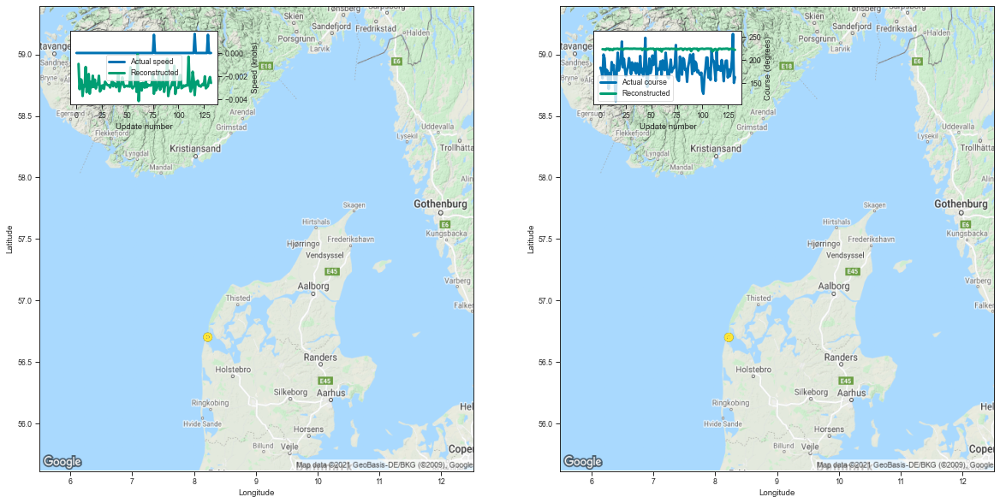

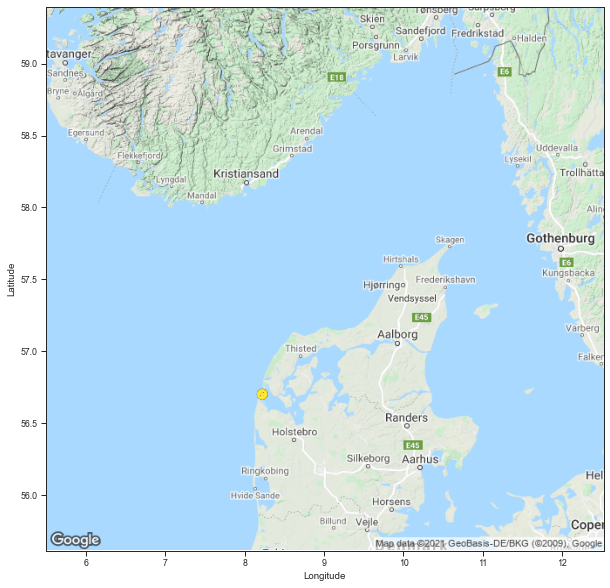

     Data set Index      Index       MMSI  Longitude   Latitude     Speed  \
0                 0  195529030  244070300   8.222977  56.703083  0.000000   
1                 0  195529030  244070300   8.222977  56.703079  0.000000   
2                 0  195529030  244070300   8.222980  56.703075  0.000000   
3                 0  195529030  244070300   8.222979  56.703075  0.000000   
4                 0  195529030  244070300   8.222975  56.703079  0.000000   
..              ...        ...        ...        ...        ...       ...   
128               0  195529030  244070300   8.222953  56.703075  0.000000   
129               0  195529030  244070300   8.222952  56.703075  0.001563   
130               0  195529030  244070300   8.222946  56.703079  0.000000   
131               0  195529030  244070300   8.222943  56.703083  0.000000   
132               0  195529030  244070300   8.222948  56.703083  0.000000   

         Course Ship type  Track length          Time stamp  
0    183.9312

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma
2,8.220399,56.701225,-0.000940,223.859283,0.007018,0.004048,0.008405,87.918969
3,8.219562,56.701416,-0.003108,223.447723,0.006739,0.003818,0.008573,88.670508
4,8.218799,56.702606,-0.002250,223.338501,0.006766,0.003812,0.008731,88.622598
5,8.218517,56.702194,-0.002326,222.395081,0.006932,0.003889,0.010921,88.386544
6,8.219214,56.702049,-0.003693,225.012299,0.006437,0.003659,0.005831,89.242179
...,...,...,...,...,...,...,...,...
128,8.219385,56.701710,-0.002949,224.657776,0.006479,0.003670,0.006361,89.103494
129,8.219280,56.702072,-0.002850,224.591446,0.006488,0.003673,0.006457,89.079491
130,8.219536,56.702248,-0.002361,224.858673,0.006470,0.003667,0.006066,89.112152
131,8.218942,56.702496,-0.002067,222.889709,0.006858,0.003853,0.009770,88.454520


In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(3)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionSkagen_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT.pth


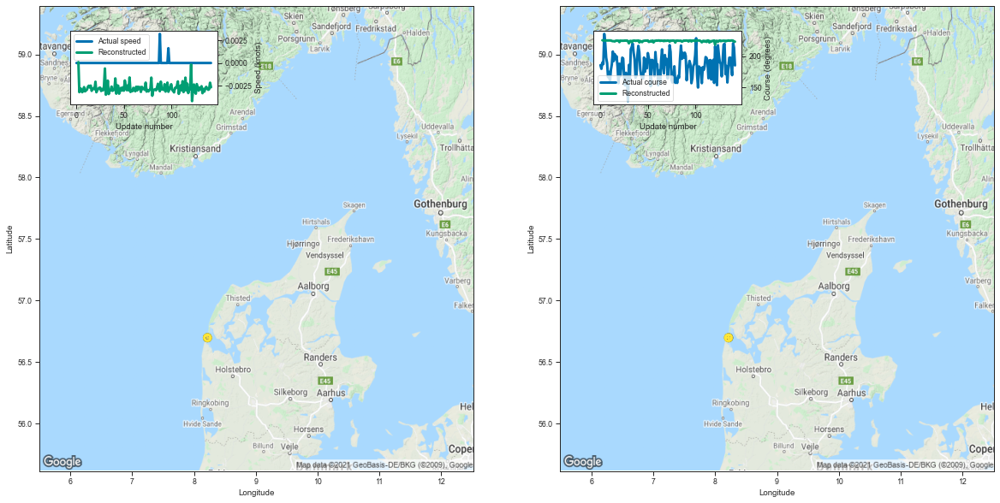

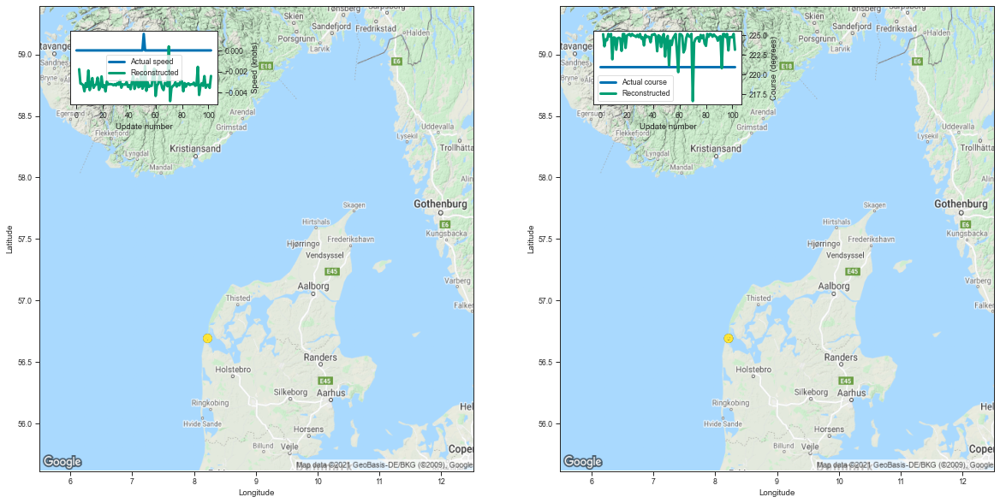

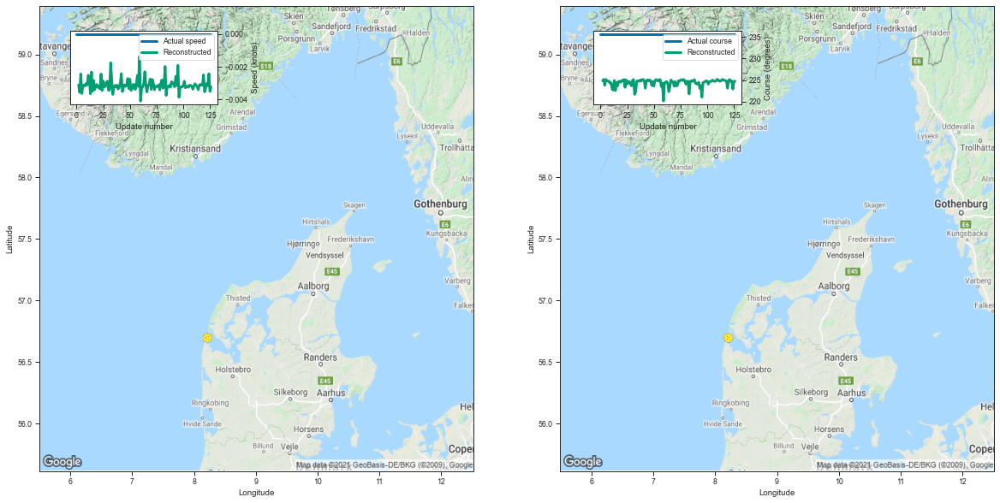

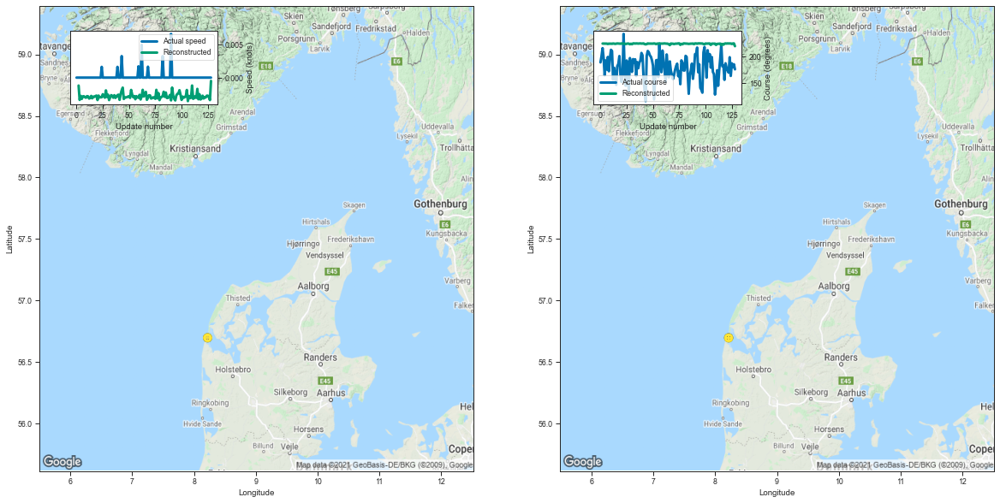

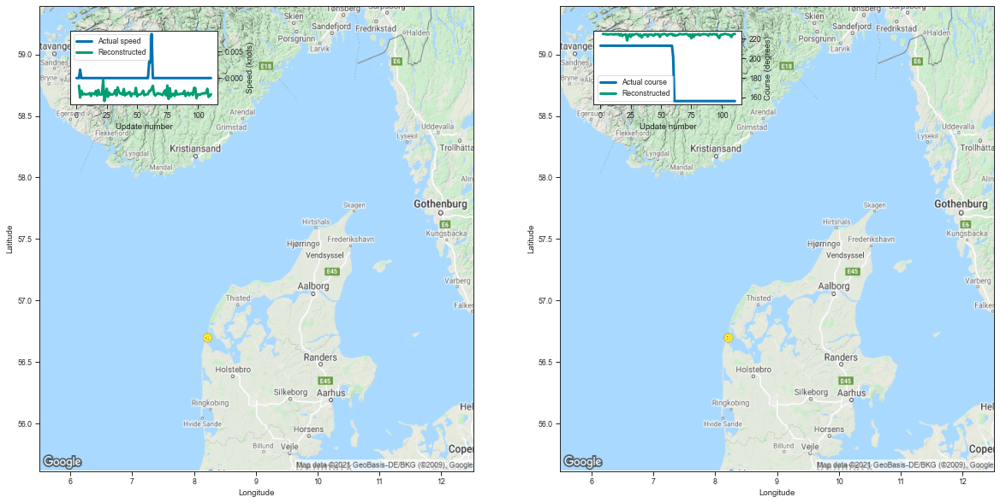

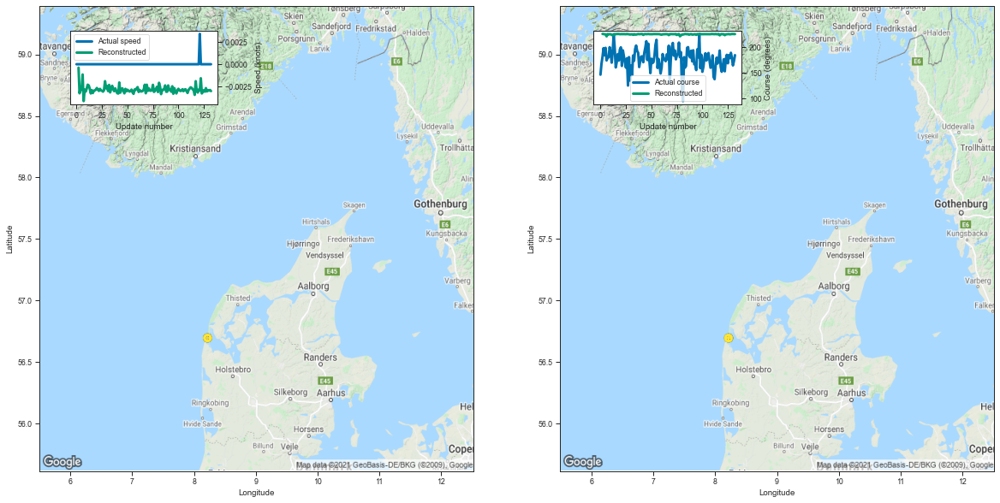

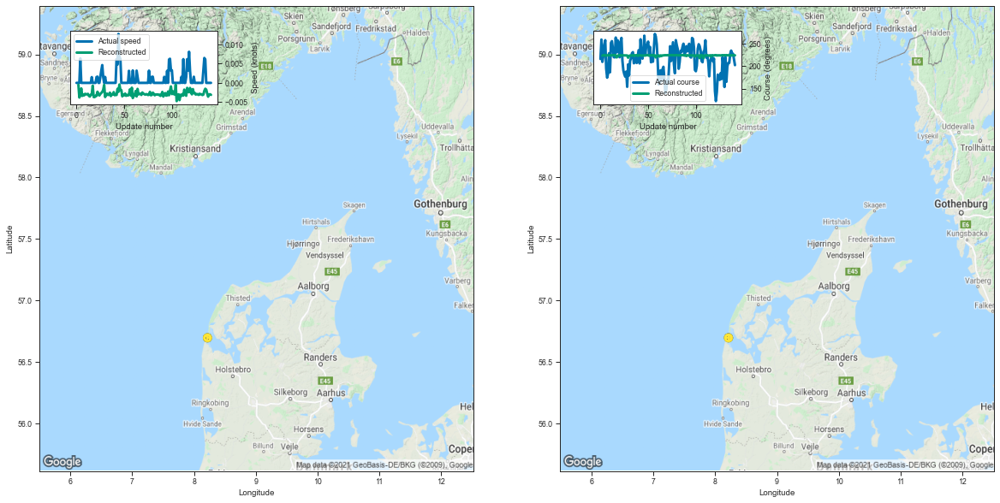

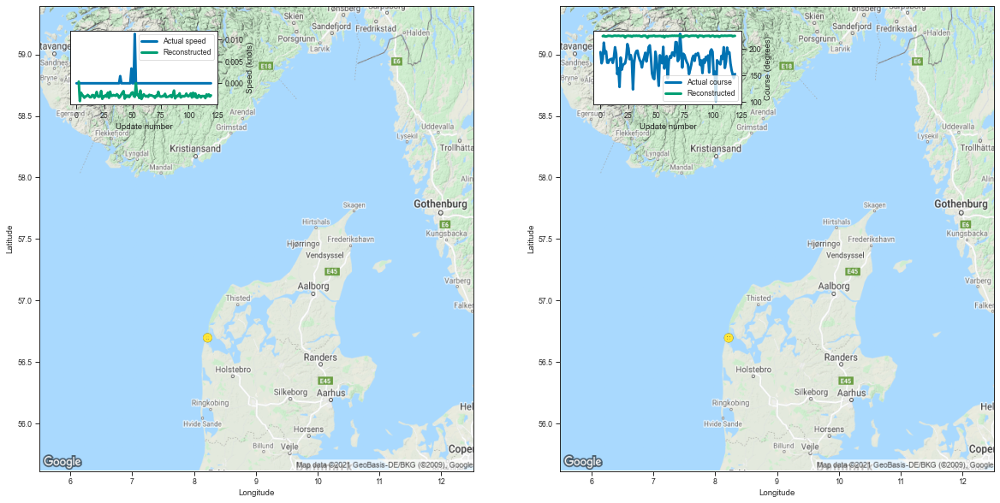

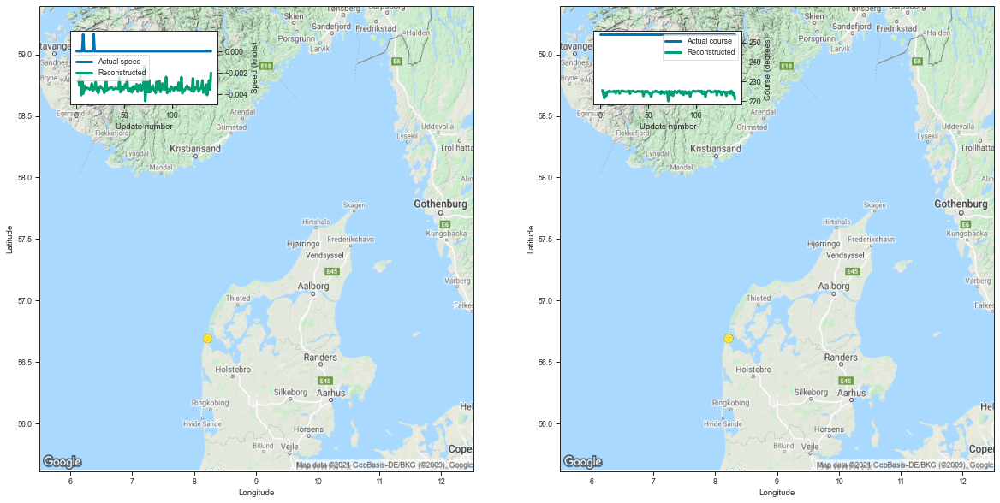

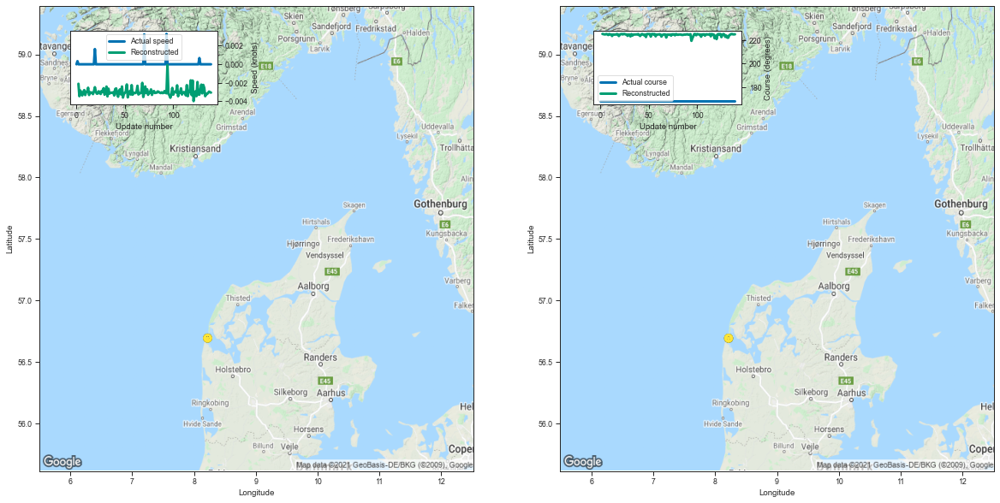

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
1298,1298,201598926,245019000,Fishing,143,1002.681641,7.011760
1068,1068,109395738,219025986,Fishing,103,719.749512,6.987859
2673,2673,117471869,219330000,Fishing,127,879.139893,6.922361
994,994,195349074,244070300,Fishing,129,892.885742,6.921595
2180,2180,210424841,257070440,Fishing,112,774.836426,6.918182
2596,2596,195285388,244070300,Fishing,133,917.072449,6.895282
715,715,161085369,220182000,Fishing,142,978.526184,6.891029
237,237,195411563,244070300,Fishing,121,833.505432,6.888475
1637,1637,125671641,219650000,Fishing,142,977.202637,6.881709
1889,1889,21642562,219001559,Fishing,140,961.935791,6.870970


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionSkagen_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT.pth


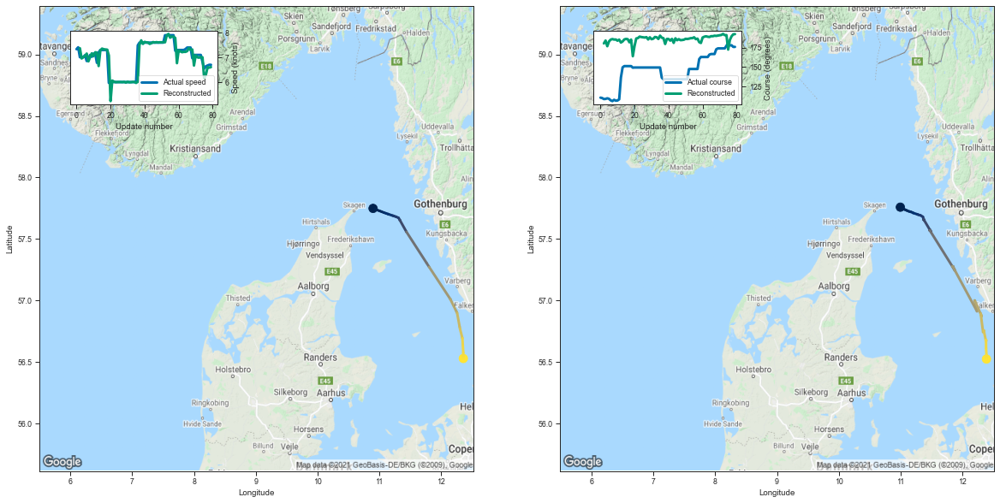

[7.372015953063965, 6.957570552825928, 7.0066094398498535, 7.055952548980713]


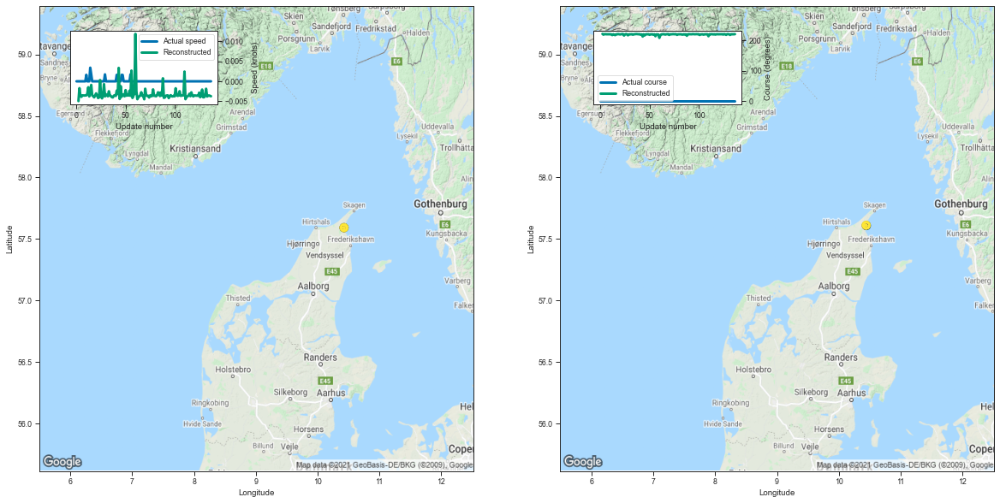

[-0.0049321651458740234, -0.0017060041427612305, -0.0037196874618530273, -0.003868699073791504]


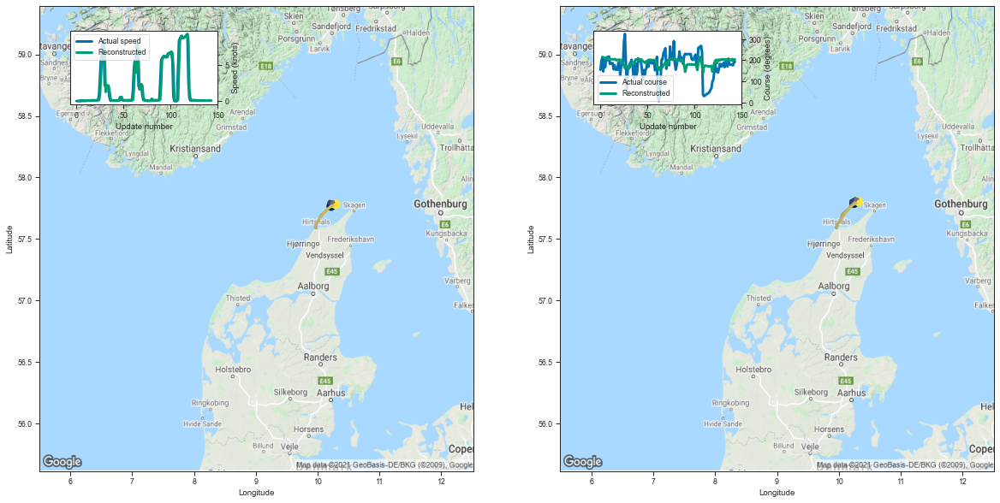

[0.006156325340270996, 0.015213370323181152, 0.02624189853668213, 0.00975334644317627]


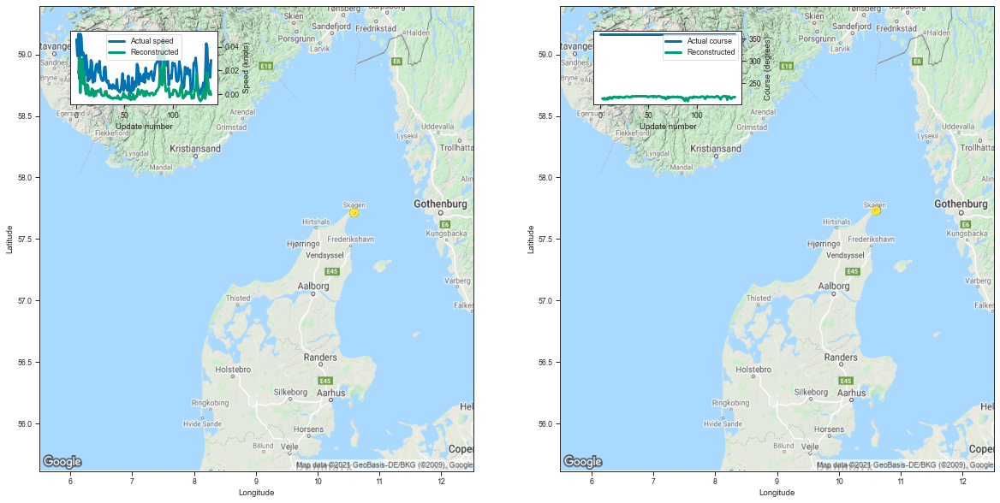

[0.017591357231140137, 0.031020641326904297, 0.0011113882064819336, 0.027910709381103516]


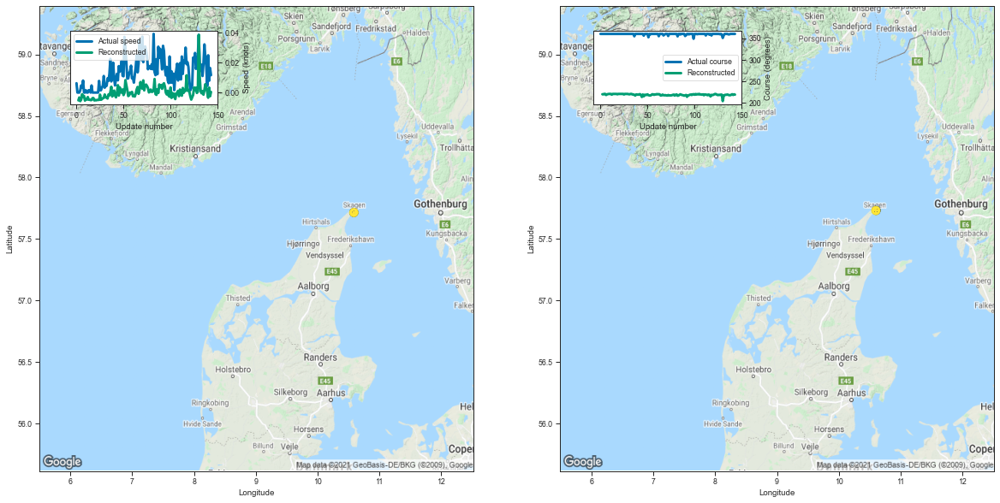

[-0.00523531436920166, -0.0032955408096313477, -0.005721926689147949, -0.004612088203430176]


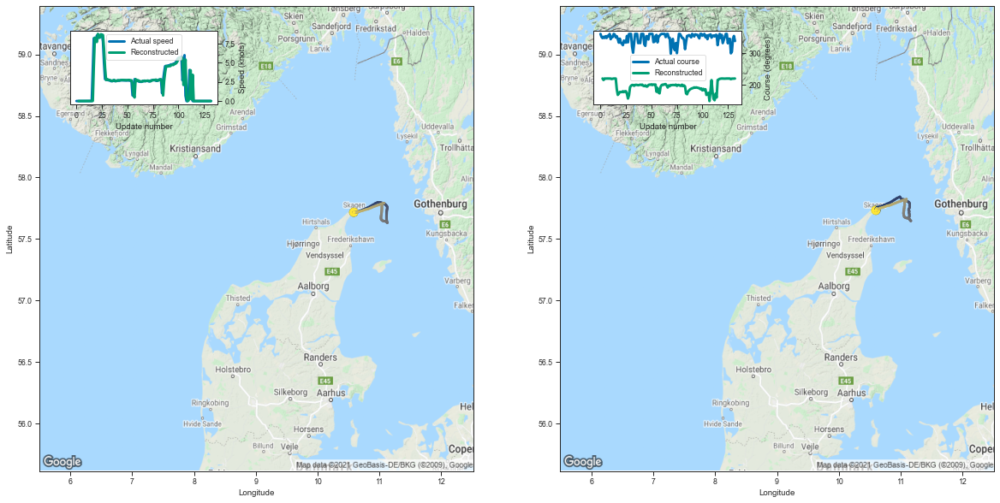

[-0.005472064018249512, 0.00043272972106933594, -0.004297614097595215, -0.004085183143615723]


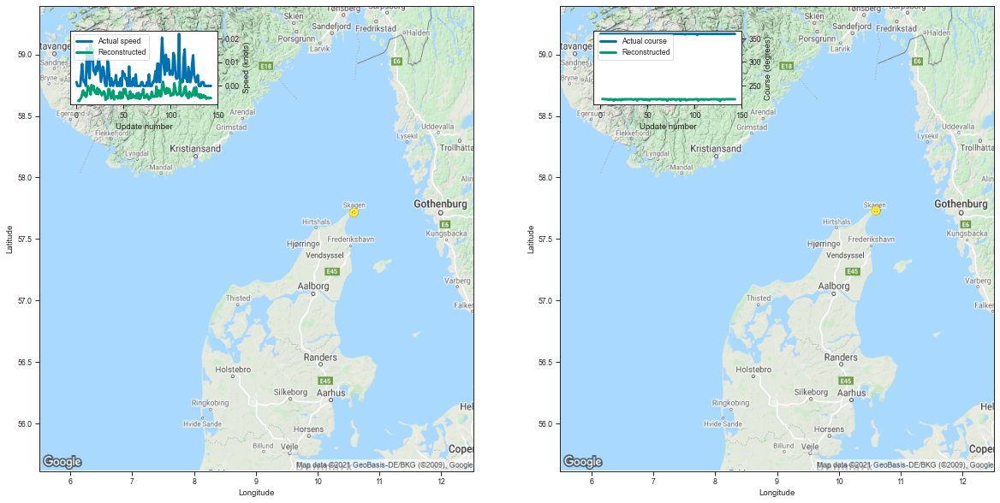

[-0.006186842918395996, -0.00637507438659668, -0.0054590702056884766, -0.004994511604309082]


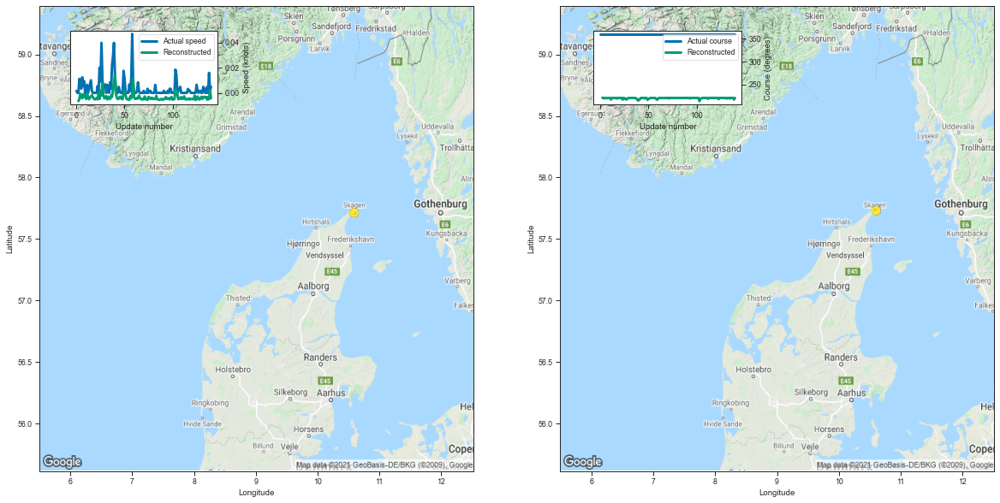

[-0.006515145301818848, -0.0048253536224365234, -0.000695347785949707, -0.0033081769943237305]


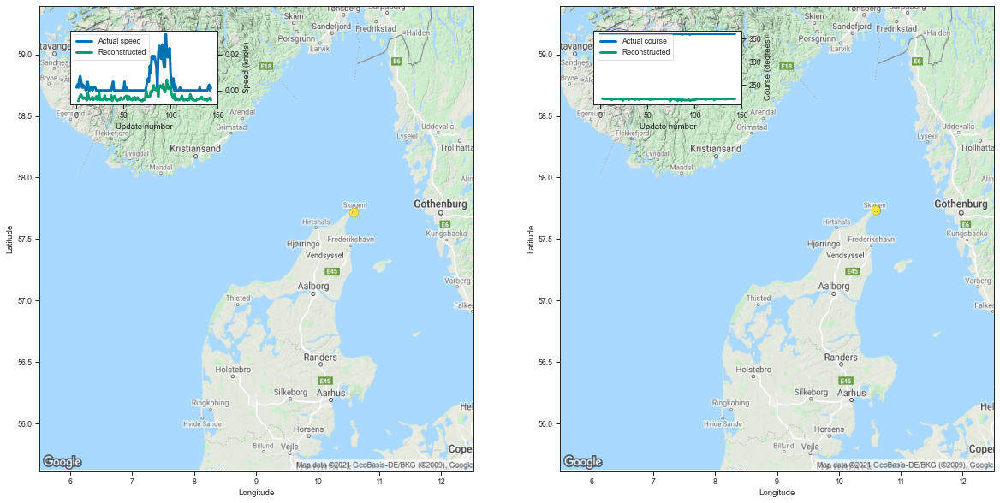

[-0.0058830976486206055, -0.0041391849517822266, -0.0027998685836791992, -0.002355337142944336]


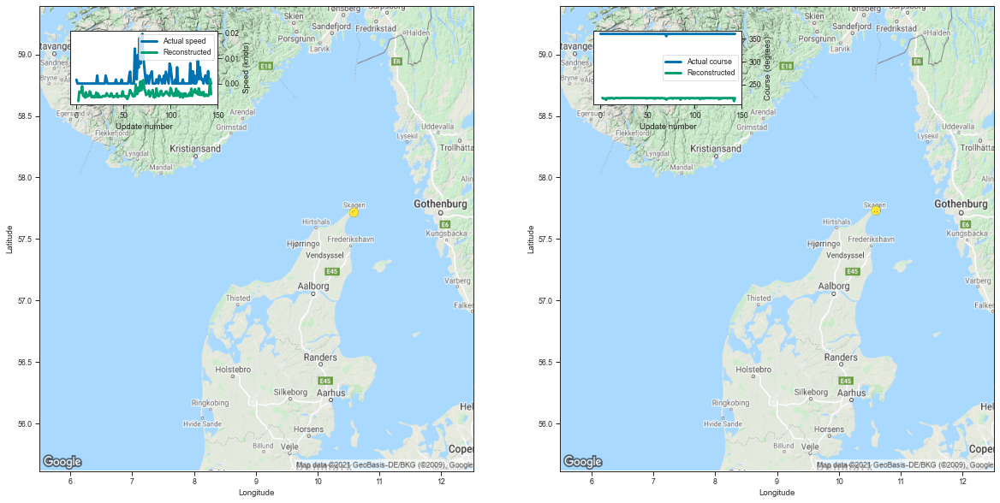

[-0.006962895393371582, -0.0031681060791015625, -0.0035191774368286133, -0.003589630126953125]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
1568,1568,107625928,219024411,Fishing,80,-1565.468384,-19.568355
1683,1683,218511549,257979790,Fishing,138,-2570.516846,-18.626934
800,800,74783139,219011018,Fishing,144,-2171.020996,-15.076535
163,163,109498085,219058000,Fishing,141,-1636.883789,-11.609105
2532,2532,79057675,219011953,Fishing,144,-1651.442383,-11.468350
1927,1927,12152858,219000897,Fishing,133,-1513.313721,-11.378299
1020,1020,78881583,219011953,Fishing,144,-1588.022583,-11.027935
2349,2349,109616112,219058000,Fishing,141,-1535.589722,-10.890707
1854,1854,79252303,219011953,Fishing,144,-1526.387451,-10.599913
2266,2266,79660095,219011953,Fishing,144,-1497.350708,-10.398269


In [10]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n

# Worst 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionSkagen_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT.pth


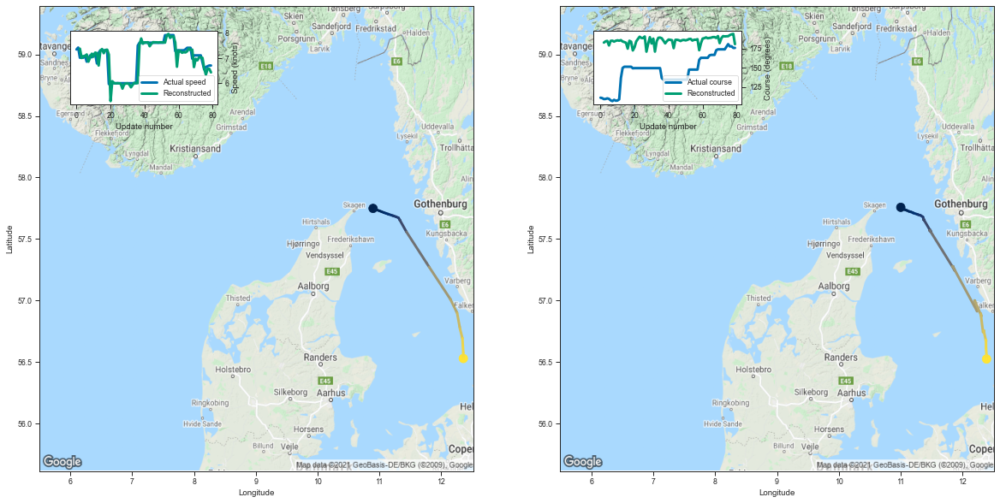

[7.36475944519043, 6.997720241546631, 7.071249008178711, 7.0593037605285645]


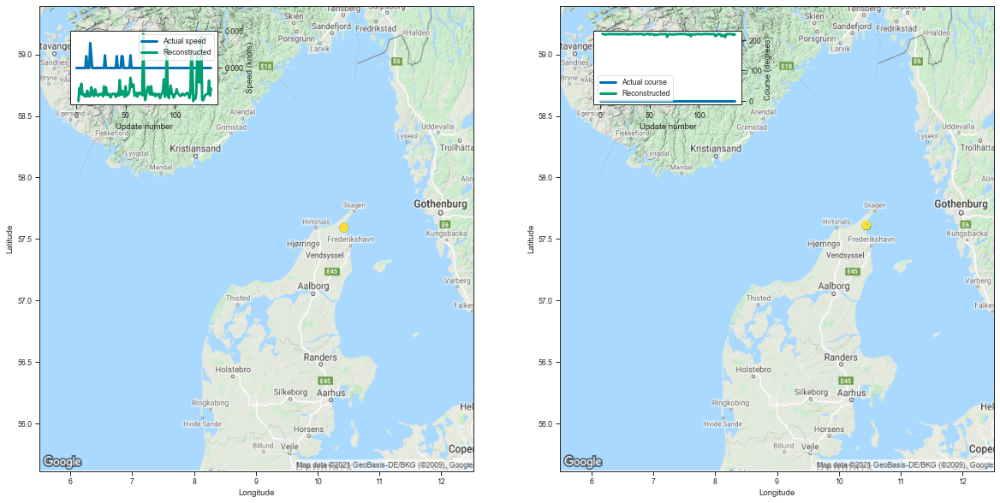

[-0.00451207160949707, -0.0027310848236083984, -0.003549814224243164, -0.0021418333053588867]


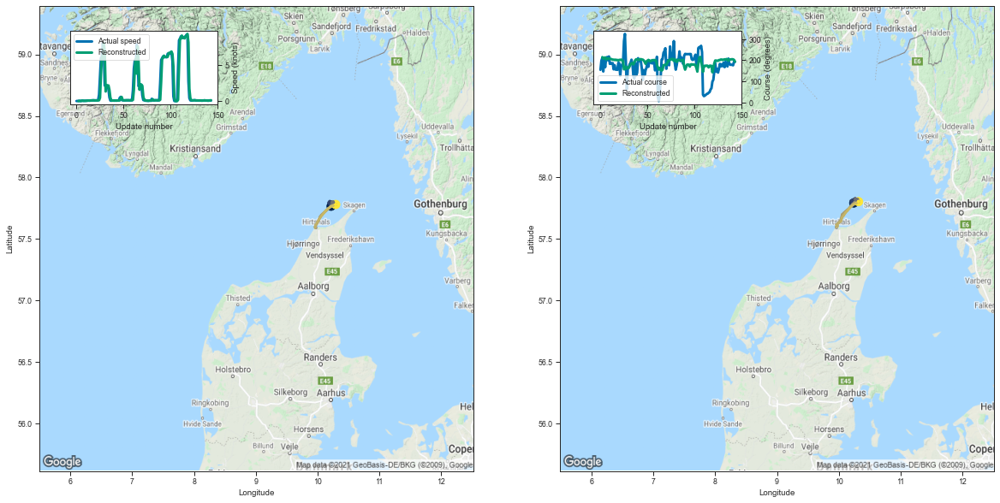

[0.0024967193603515625, 0.033345580101013184, 0.028252124786376953, 0.007822513580322266]


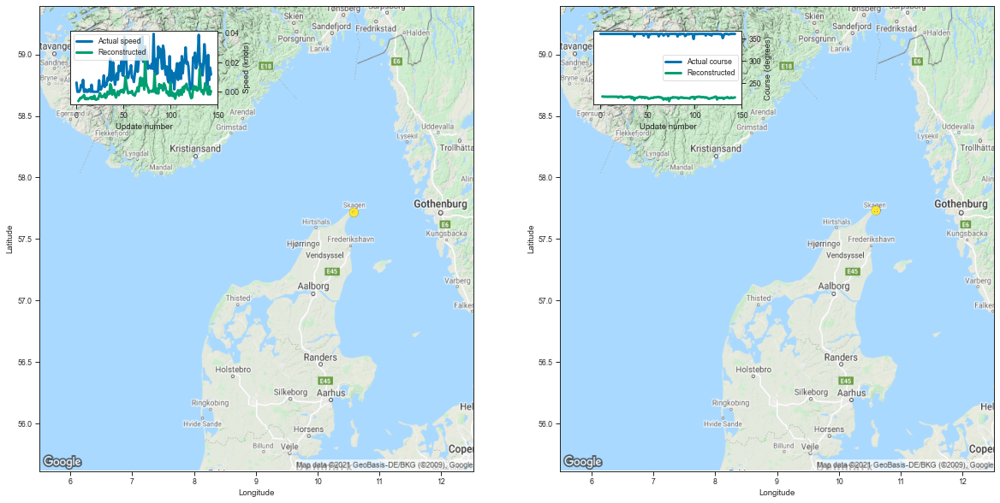

[-0.006338715553283691, -0.005363583564758301, -0.004183530807495117, -0.004464268684387207]


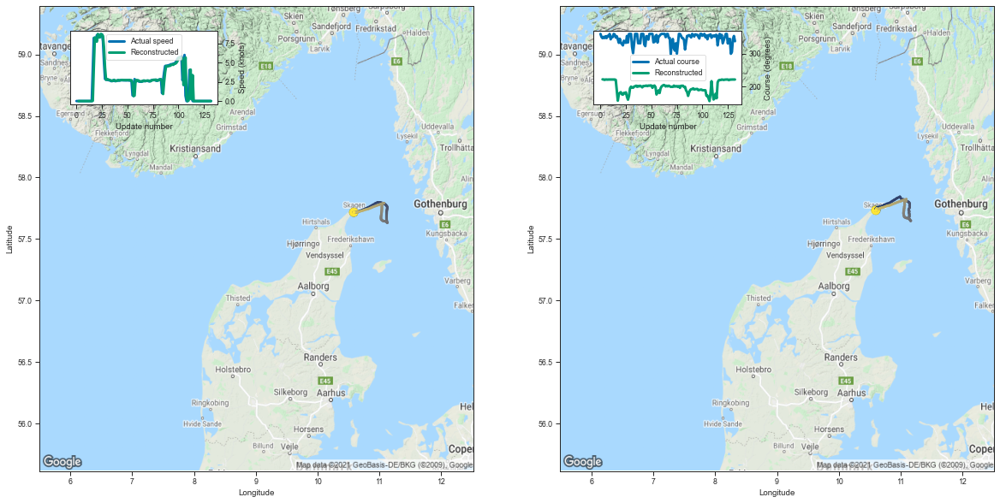

[-0.0057343244552612305, -0.004222512245178223, -0.0032862424850463867, -0.003978371620178223]


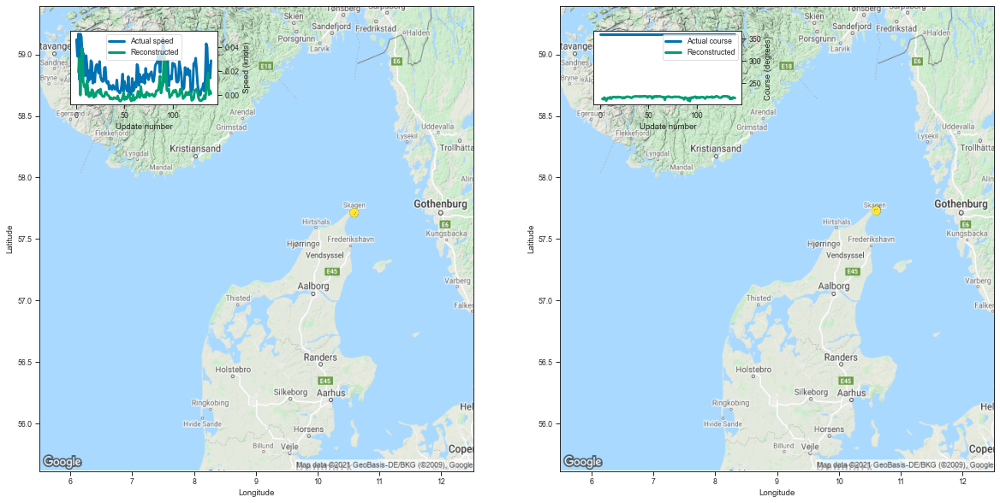

[0.019153356552124023, 0.030684471130371094, -5.5670738220214844e-05, 0.02183401584625244]


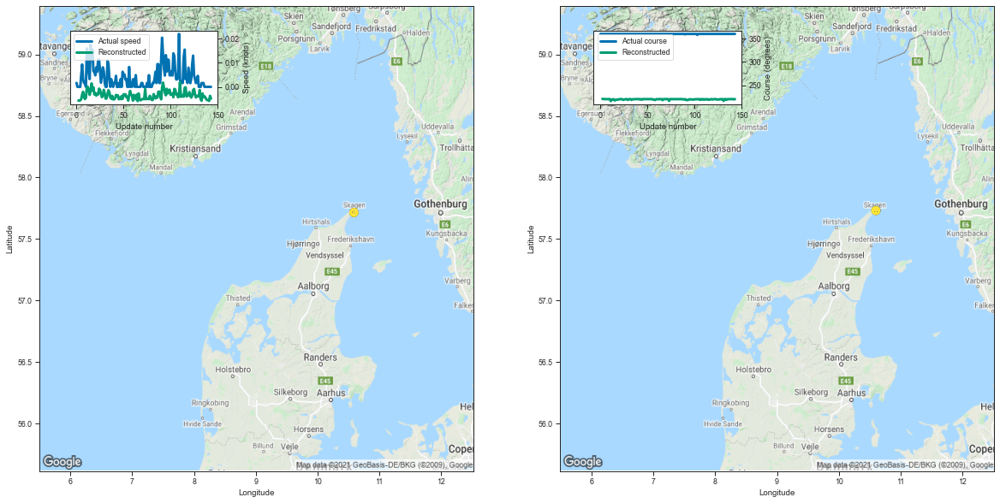

[-0.005655050277709961, -0.005743622779846191, -0.005555510520935059, -0.005064845085144043]


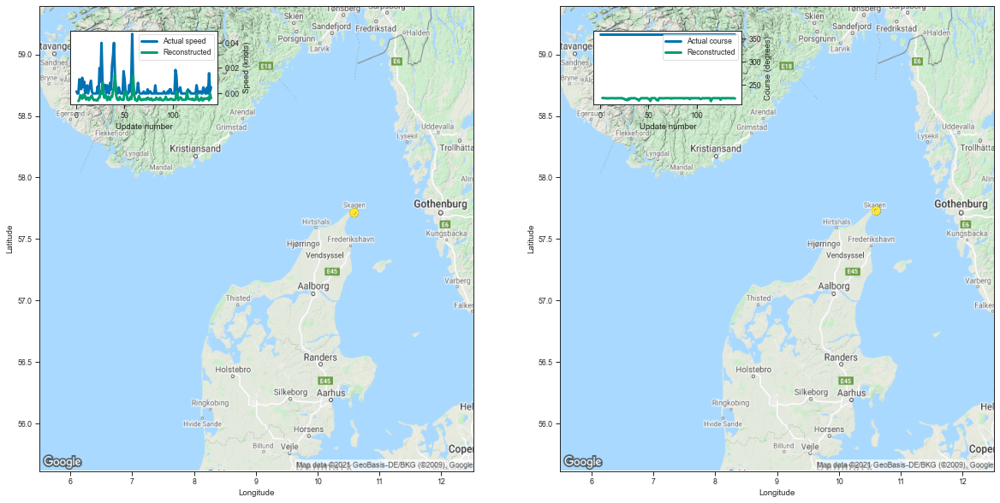

[-0.005987286567687988, -0.004663944244384766, -0.0014215707778930664, -0.0034346580505371094]


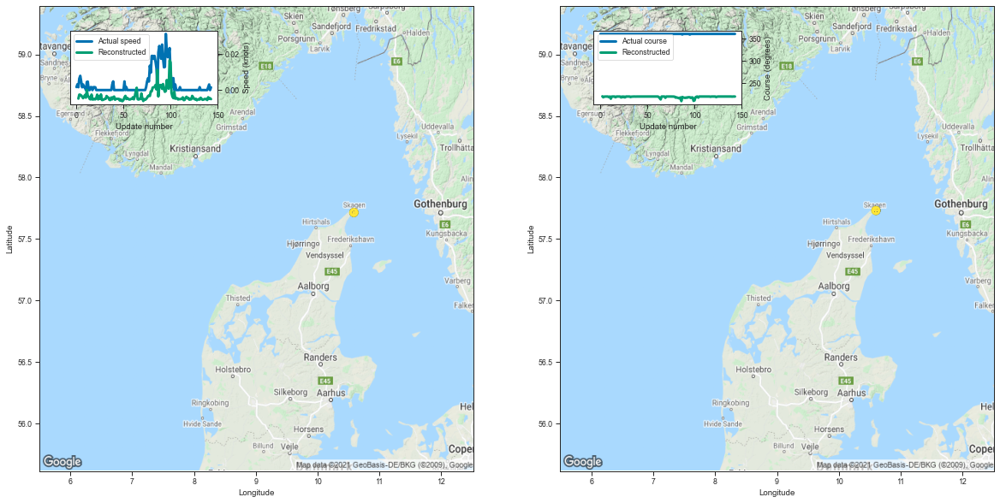

[-0.004761815071105957, -0.002537965774536133, -0.0026363134384155273, -0.003017425537109375]


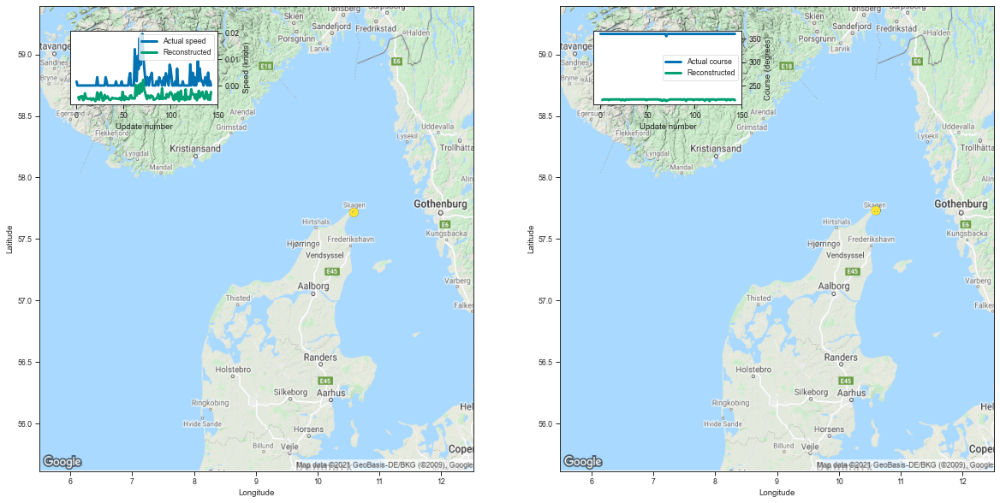

[-0.004439115524291992, -0.00541234016418457, -0.0042150020599365234, -0.004343152046203613]


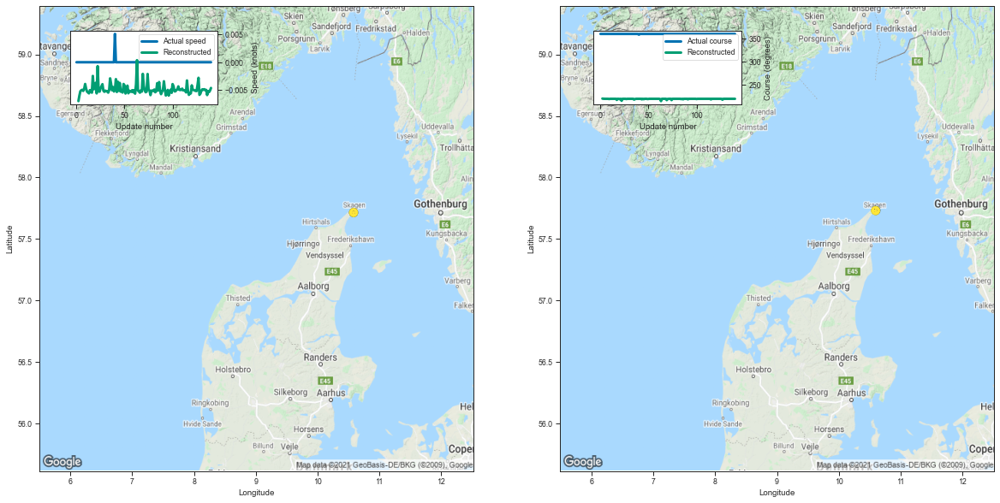

[-0.006970524787902832, -0.006007552146911621, -0.00521695613861084, -0.005027890205383301]


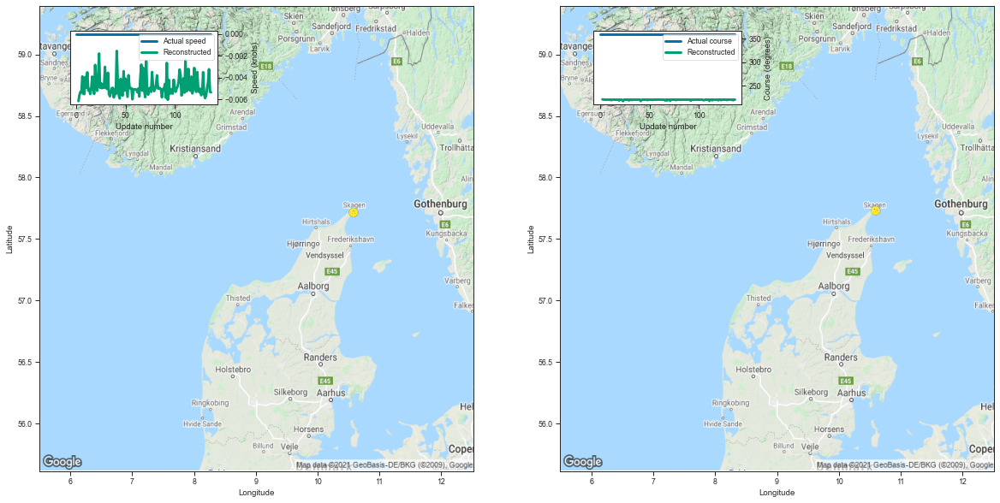

[-0.006156802177429199, -0.005612730979919434, -0.005315065383911133, -0.005374312400817871]


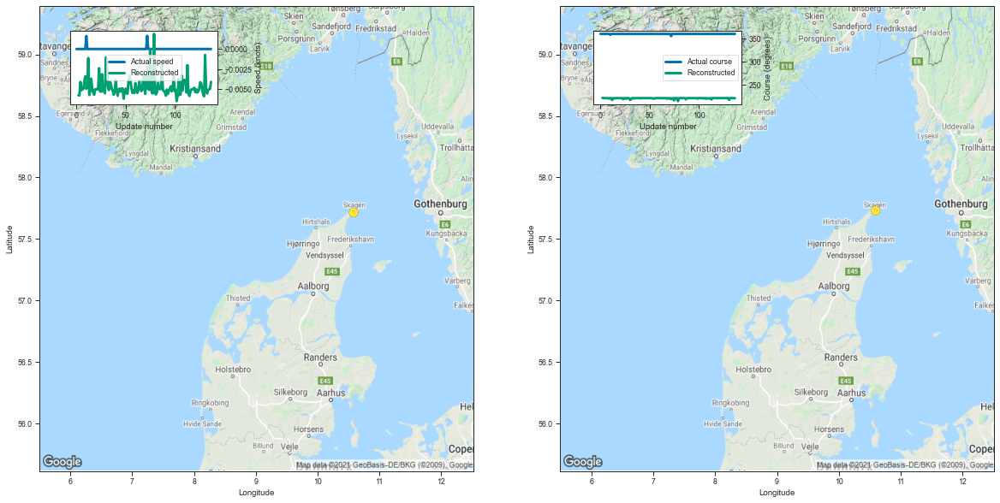

[-0.005750894546508789, -0.005766034126281738, -0.004093766212463379, -0.005136370658874512]


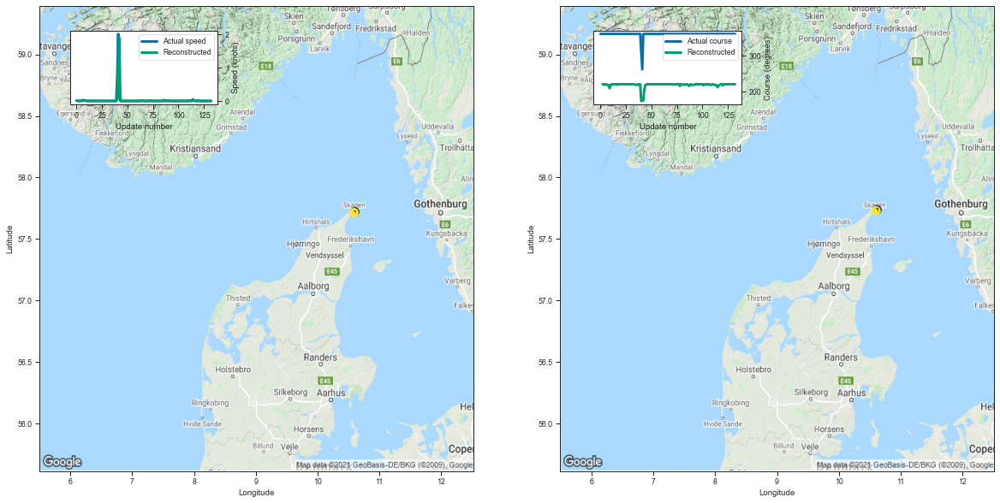

[-0.0032410621643066406, -0.005306720733642578, -0.0023976564407348633, -0.0030117034912109375]


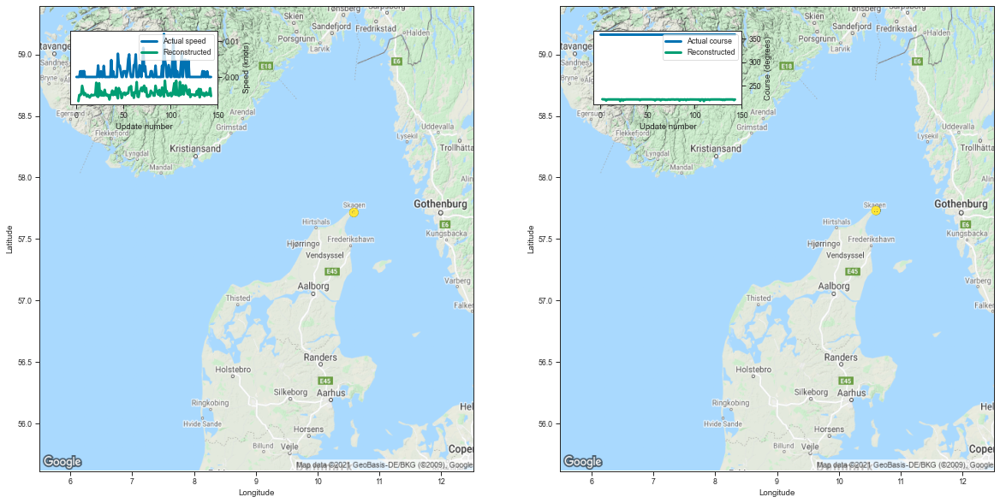

[-0.006691694259643555, -0.004998922348022461, -0.00509190559387207, -0.0047647953033447266]


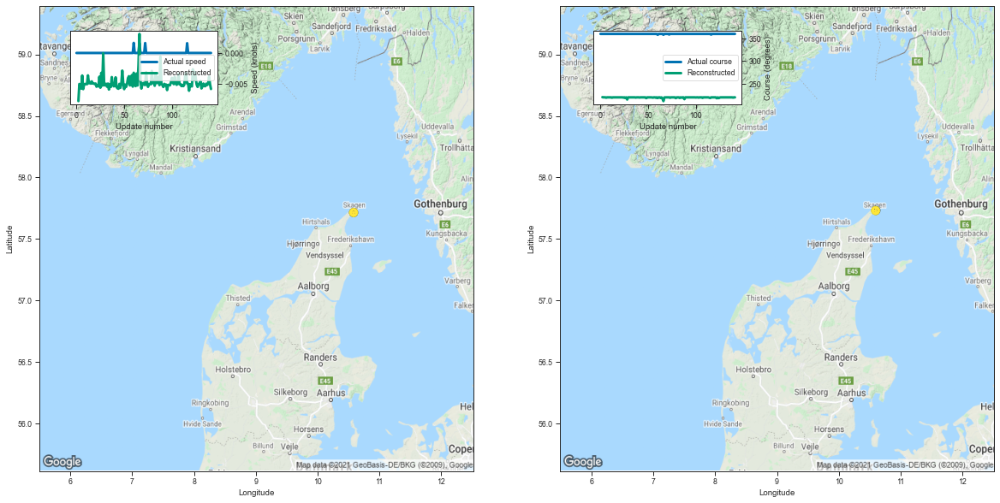

[-0.007812142372131348, -0.005035042762756348, -0.005229592323303223, -0.005778908729553223]


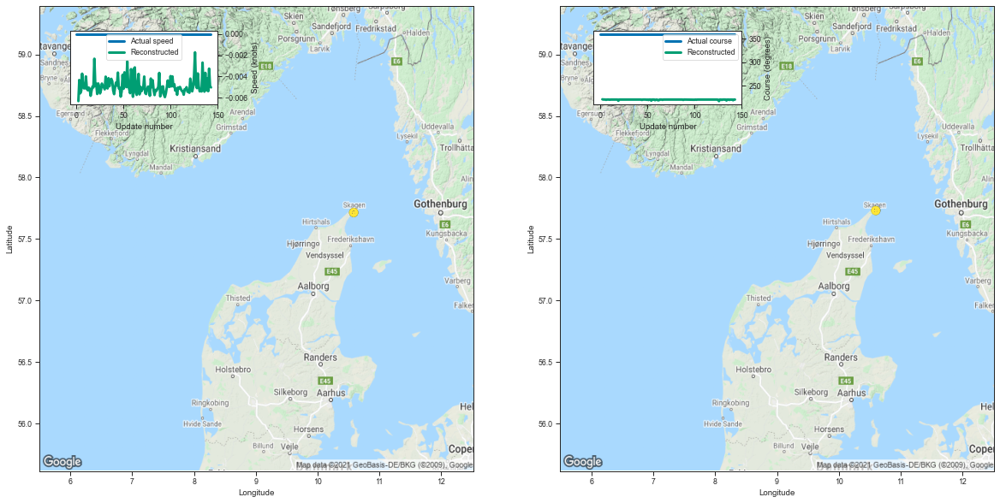

[-0.006305694580078125, -0.004325151443481445, -0.0055686235427856445, -0.005330443382263184]


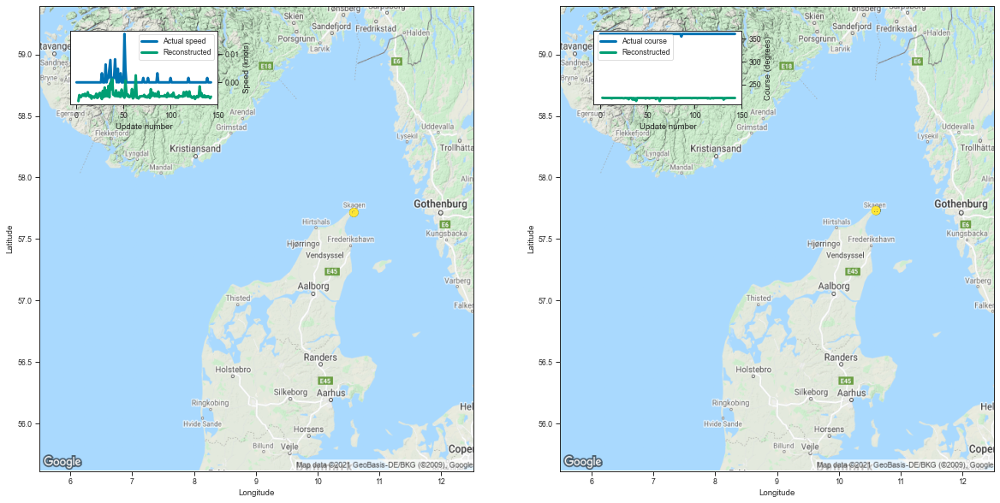

[-0.00664520263671875, -0.004516243934631348, -0.005256772041320801, -0.005157351493835449]


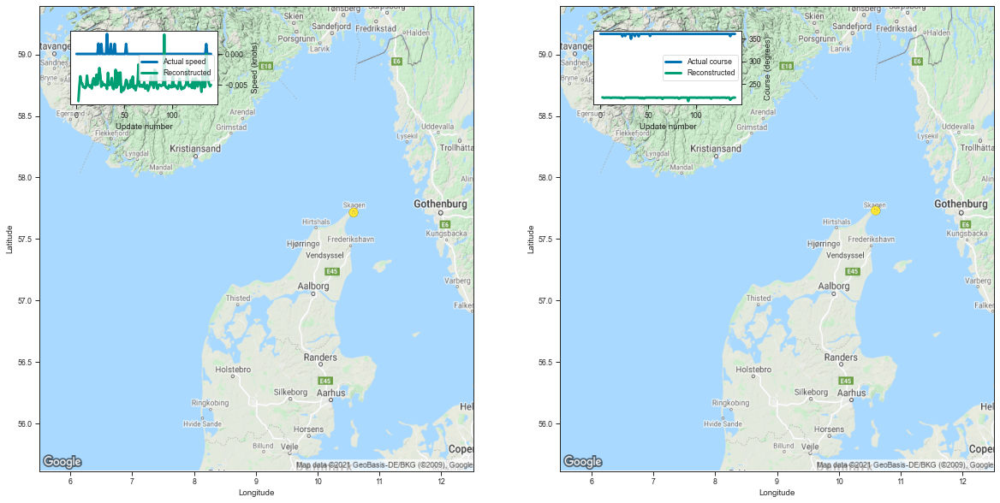

[-0.007593274116516113, -0.005263328552246094, -0.0035910606384277344, -0.004641890525817871]


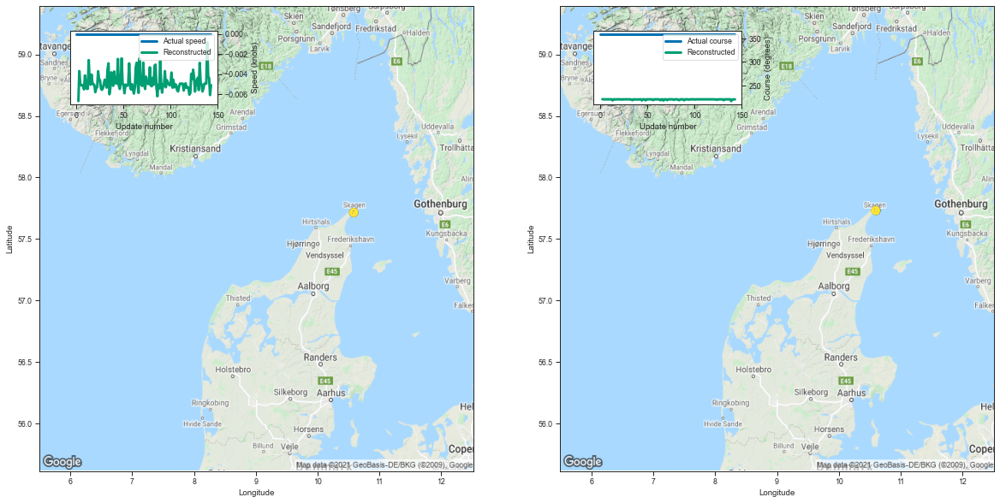

[-0.006675362586975098, -0.0036901235580444336, -0.004958629608154297, -0.005104541778564453]


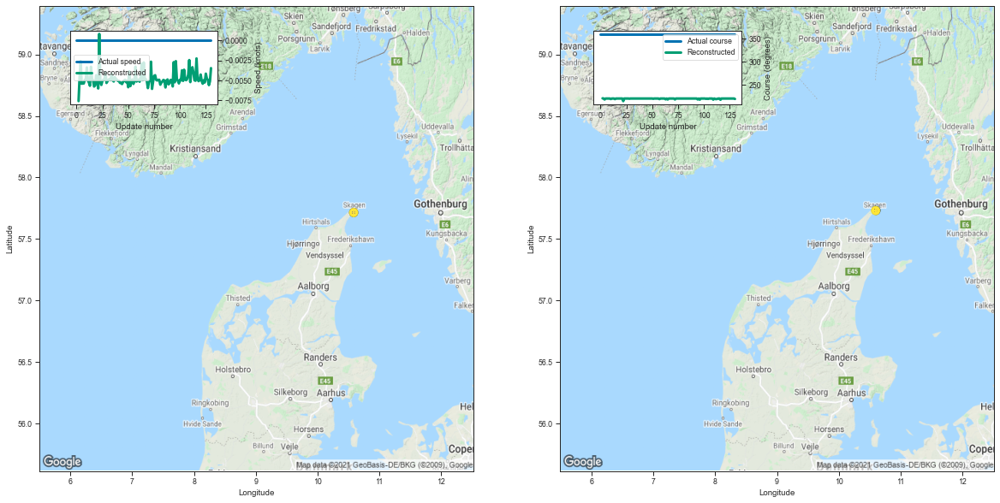

[-0.007615804672241211, -0.004619717597961426, -0.002582073211669922, -0.005433440208435059]


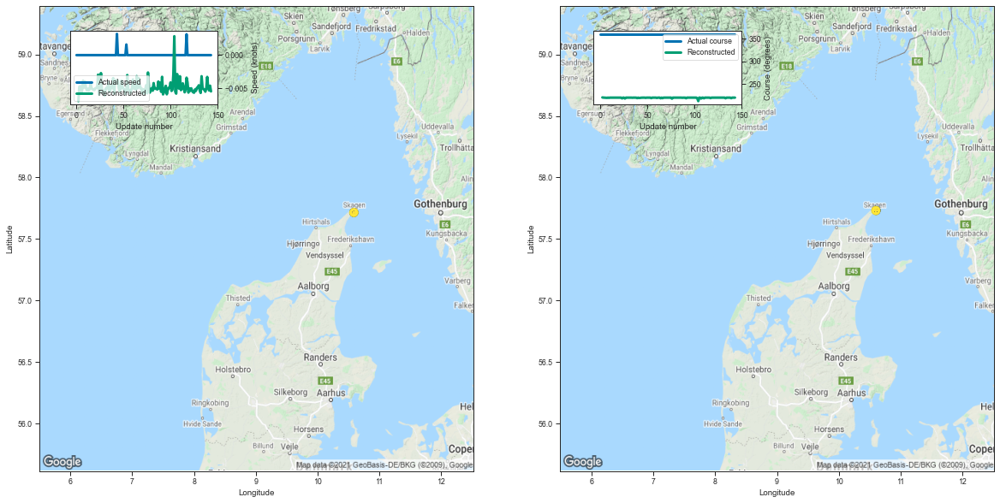

[-0.006879687309265137, -0.004743695259094238, -0.004651308059692383, -0.0056084394454956055]


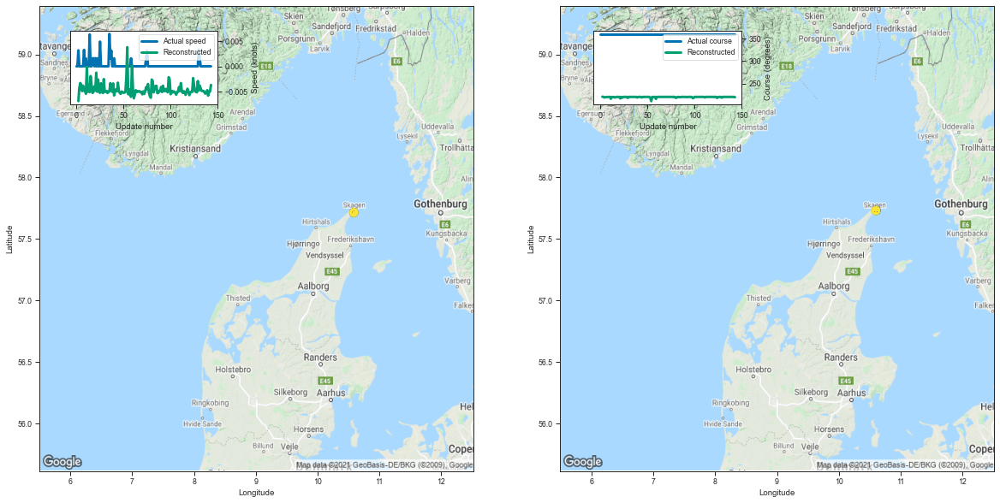

[-0.00692439079284668, -0.0043212175369262695, -0.0033299922943115234, -0.003655552864074707]


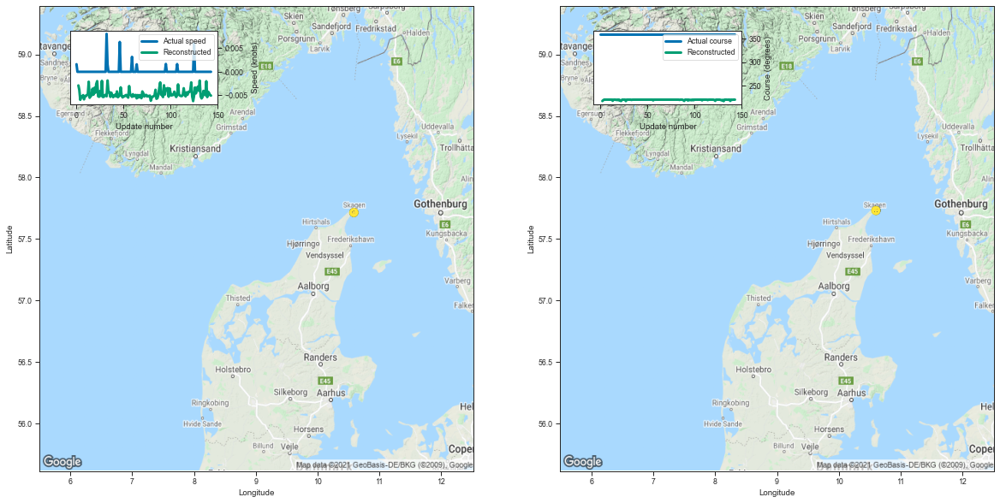

[-0.002900838851928711, -0.003865838050842285, -0.00595402717590332, -0.005231738090515137]


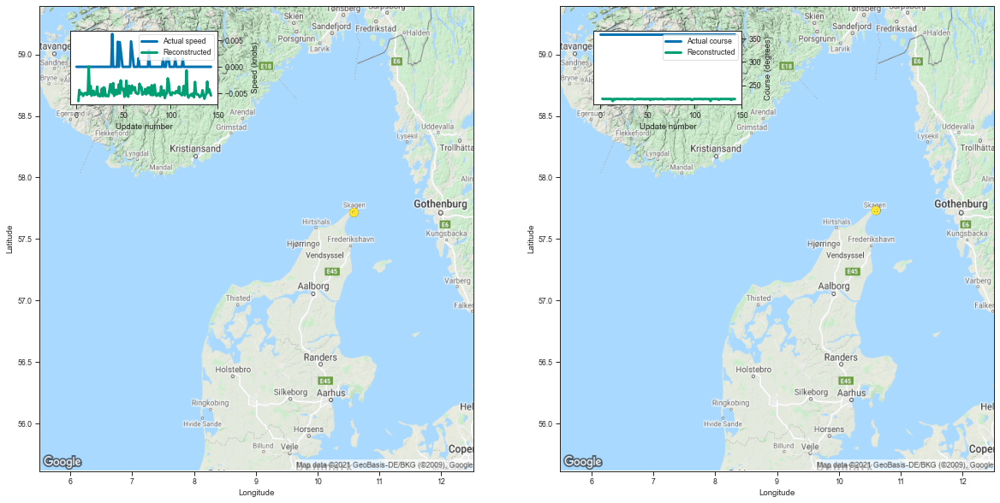

[-0.006408572196960449, -0.004319429397583008, -0.0051457881927490234, -0.004915356636047363]


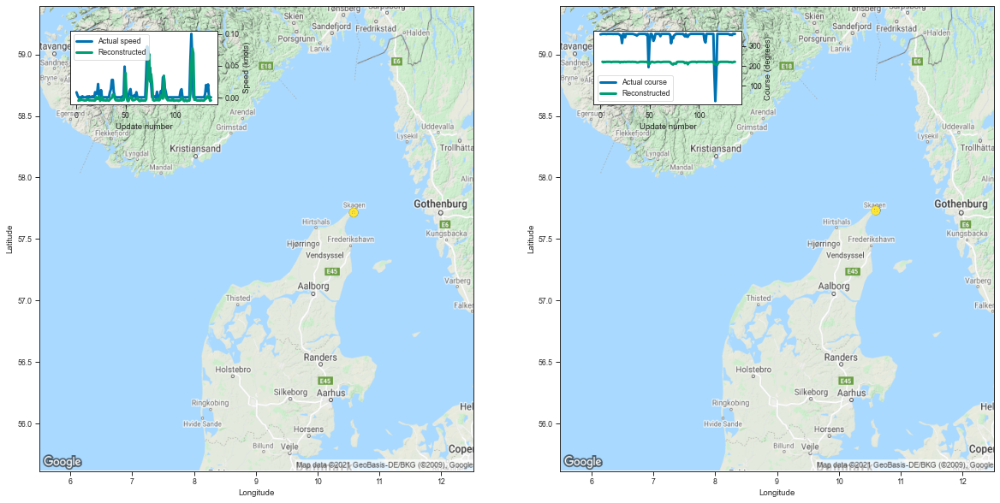

[-0.005442619323730469, -0.002620220184326172, -0.004794716835021973, -0.0035780668258666992]


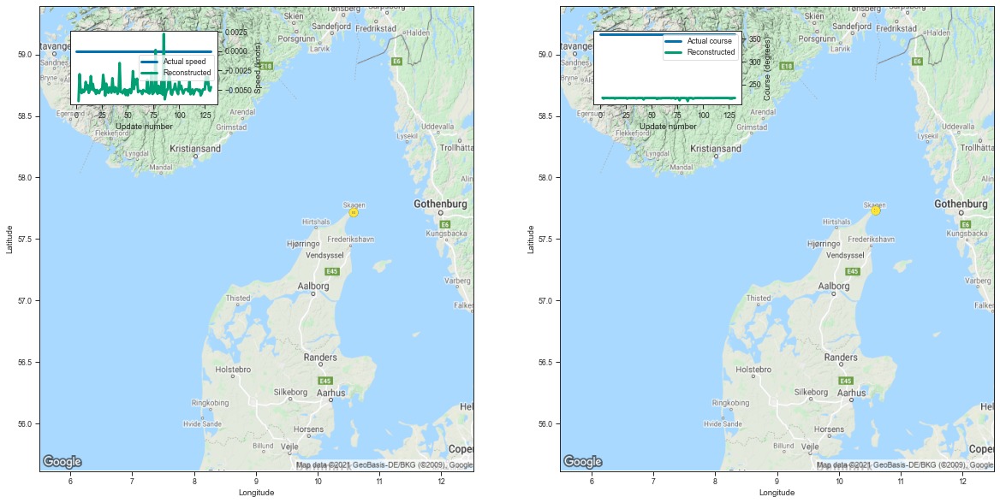

[-0.006442427635192871, -0.0029828548431396484, -0.0050781965255737305, -0.005416989326477051]


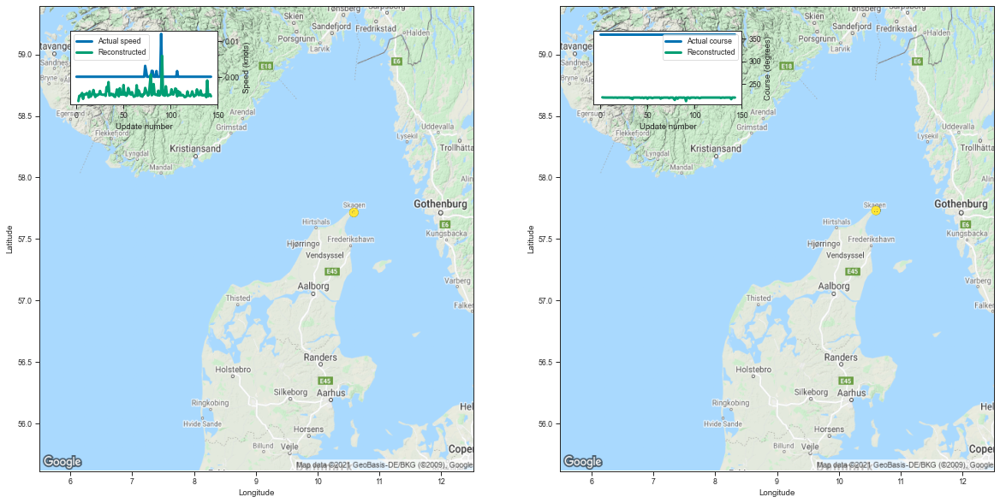

[-0.006785750389099121, -0.005322098731994629, -0.0054433345794677734, -0.004956841468811035]


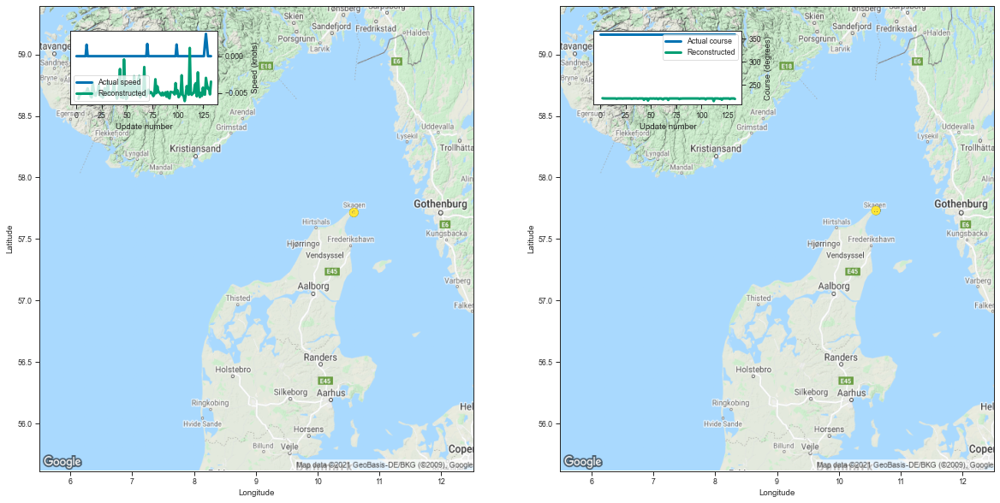

[-0.005803465843200684, -0.005256056785583496, -0.005225419998168945, -0.005066275596618652]


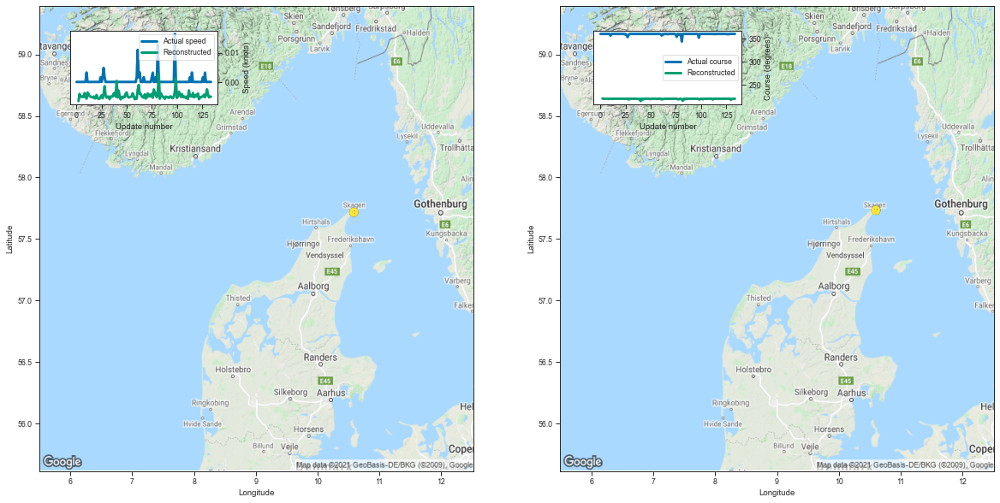

[-0.0065348148345947266, -0.004086852073669434, -0.005012869834899902, -0.005122780799865723]


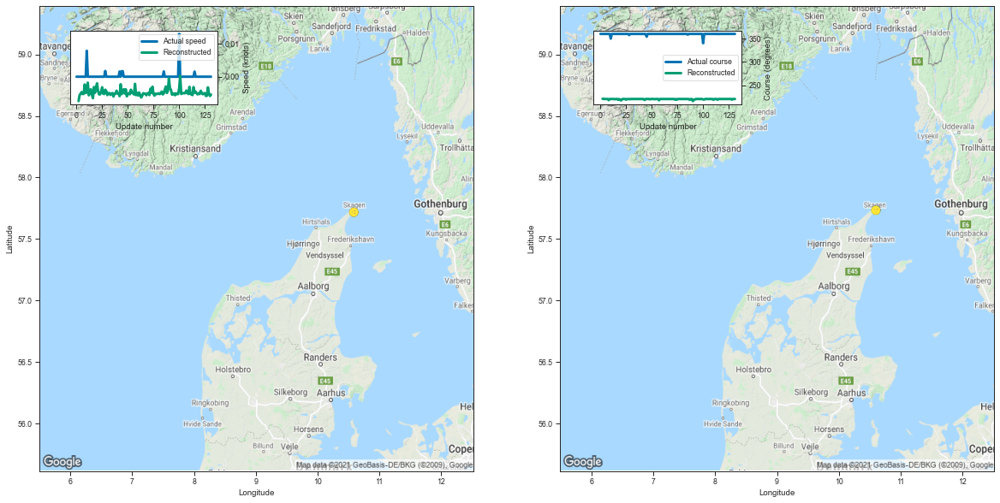

[-0.007347822189331055, -0.0055849552154541016, -0.005084395408630371, -0.0046274662017822266]


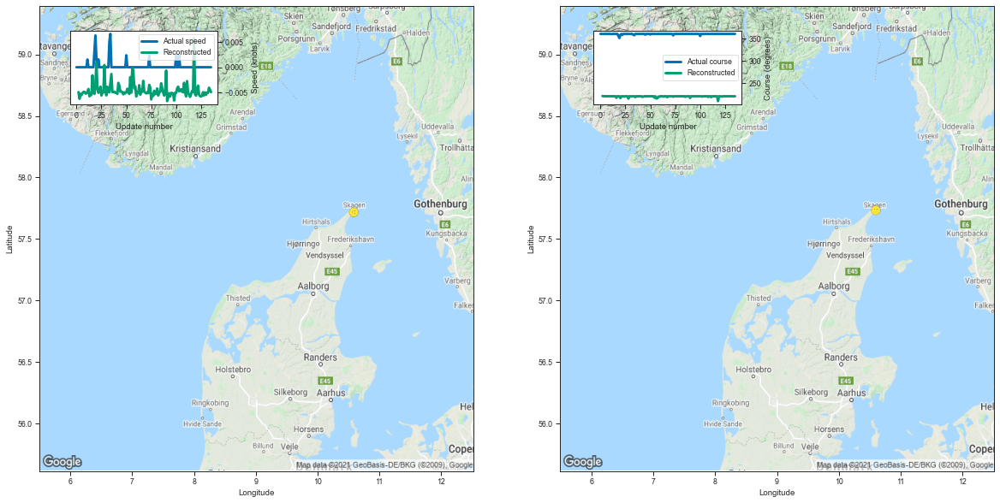

[-0.004972338676452637, -0.006306171417236328, -0.005341291427612305, -0.005578279495239258]


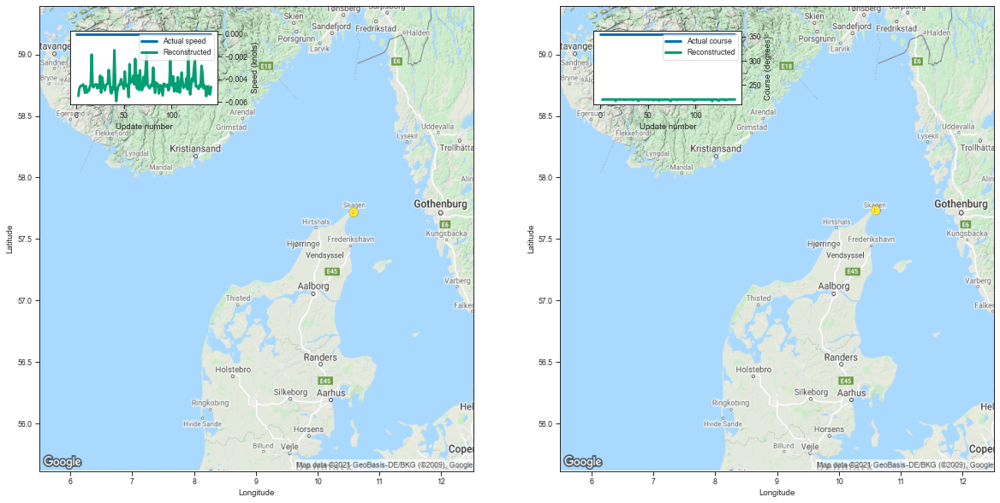

[-0.005468964576721191, -0.004817843437194824, -0.004627346992492676, -0.004559874534606934]


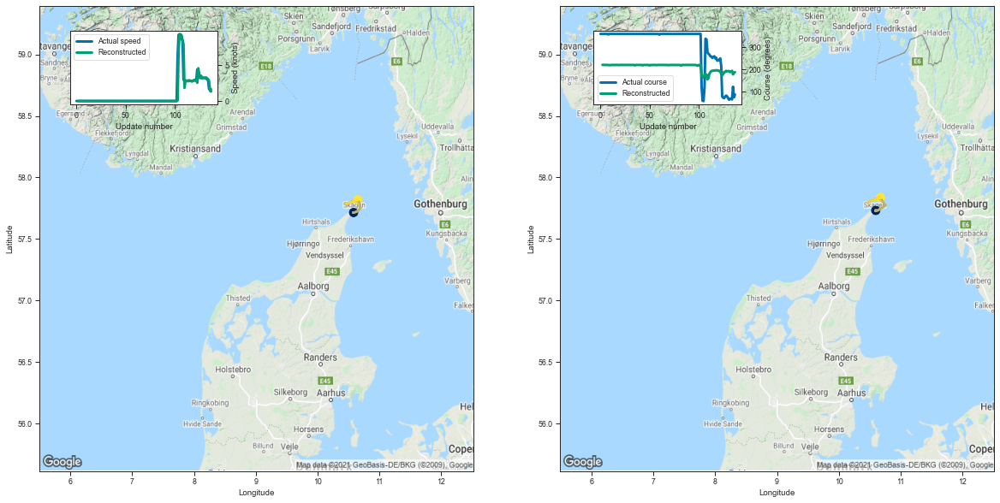

[-0.005066514015197754, -0.006500720977783203, -0.006259560585021973, -0.004864931106567383]


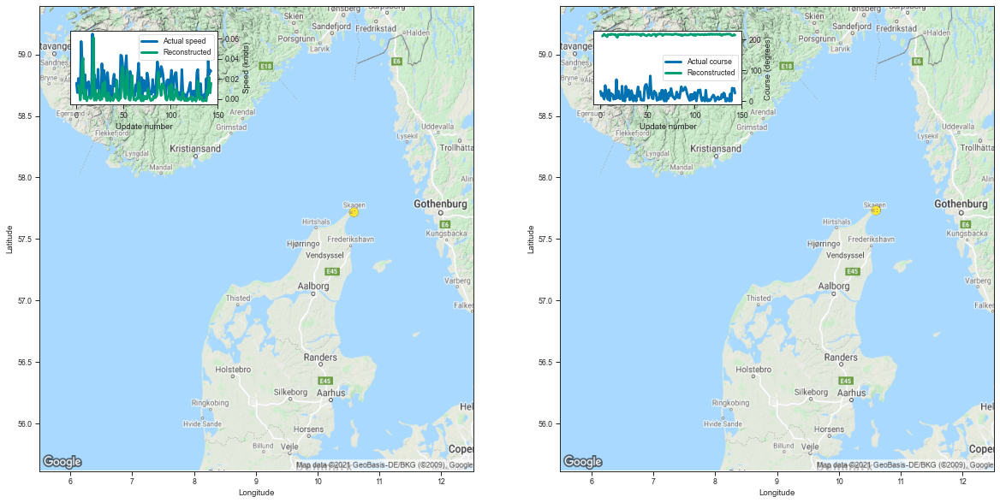

[0.013395190238952637, 0.00988912582397461, -0.0011321306228637695, 0.007994771003723145]


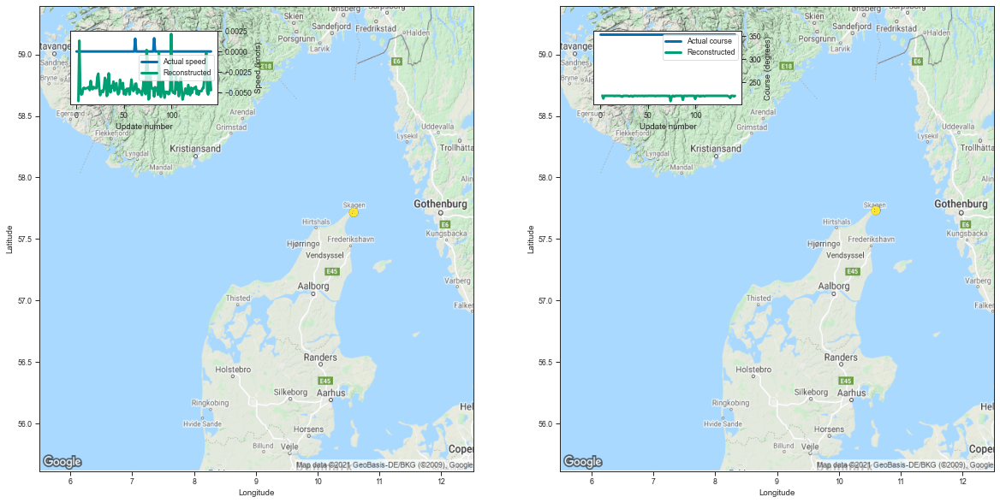

[-0.0060346126556396484, 0.0013123750686645508, -0.004799962043762207, -0.005239725112915039]


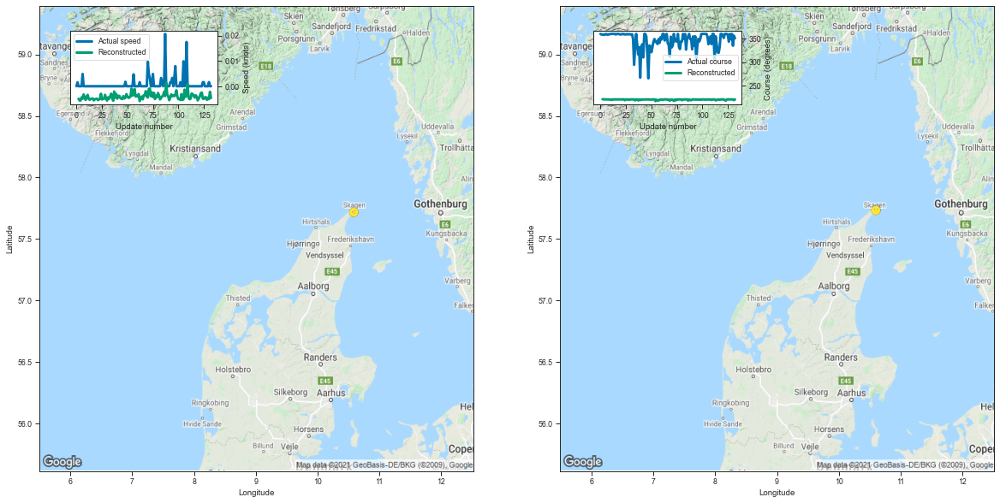

[-0.004955649375915527, -0.005620121955871582, -0.005595088005065918, -0.004408001899719238]


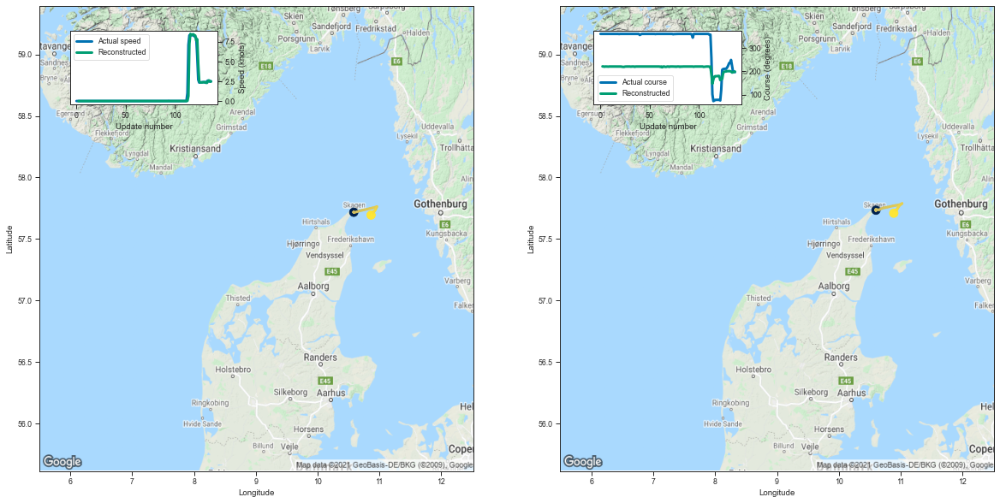

[-0.00658261775970459, -0.005653500556945801, -0.003518223762512207, -0.005121827125549316]


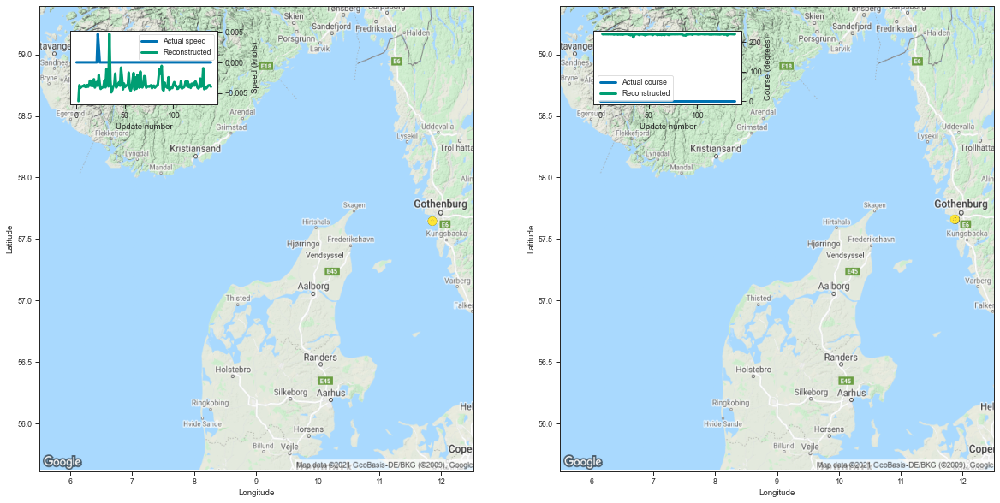

[-0.0063359737396240234, -0.003731369972229004, -0.004189848899841309, -0.0039751529693603516]


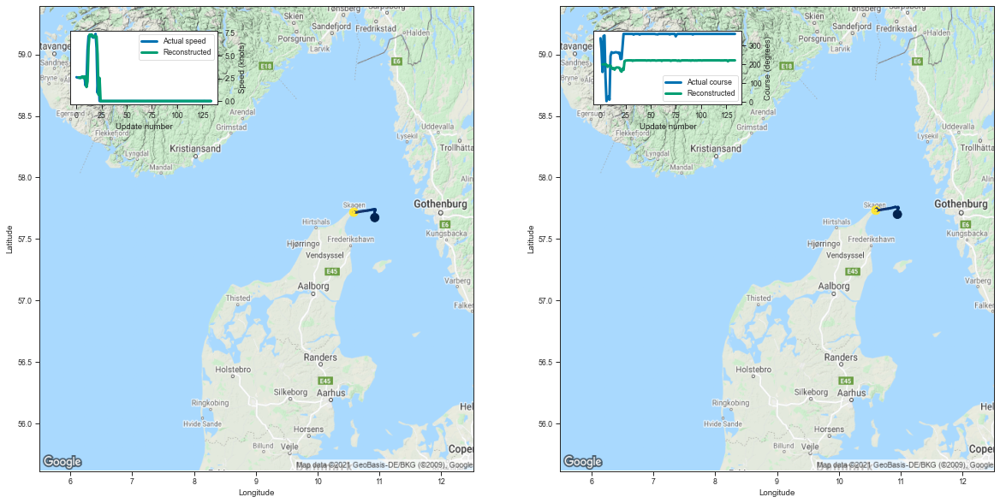

[2.574425220489502, 2.6141562461853027, 2.5542702674865723, 2.571078300476074]


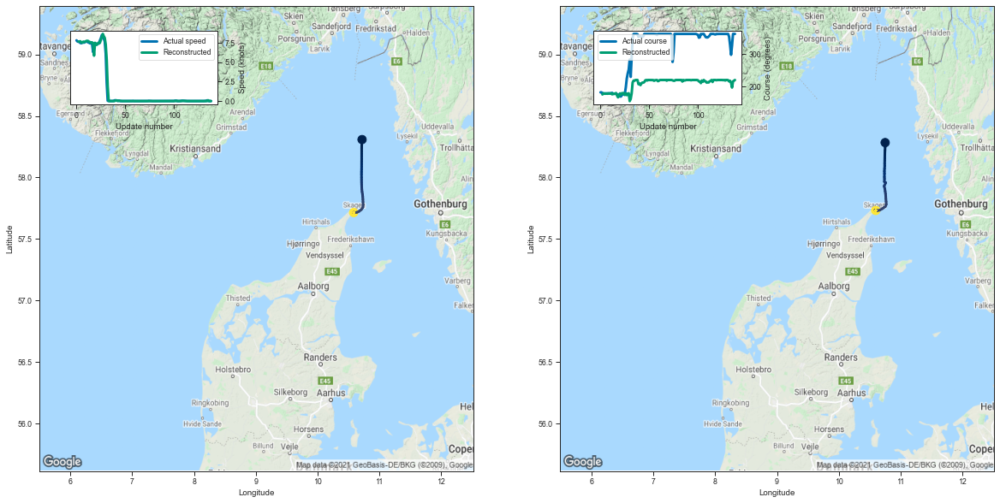

[7.6487956047058105, 7.6675519943237305, 7.676437854766846, 7.519498348236084]


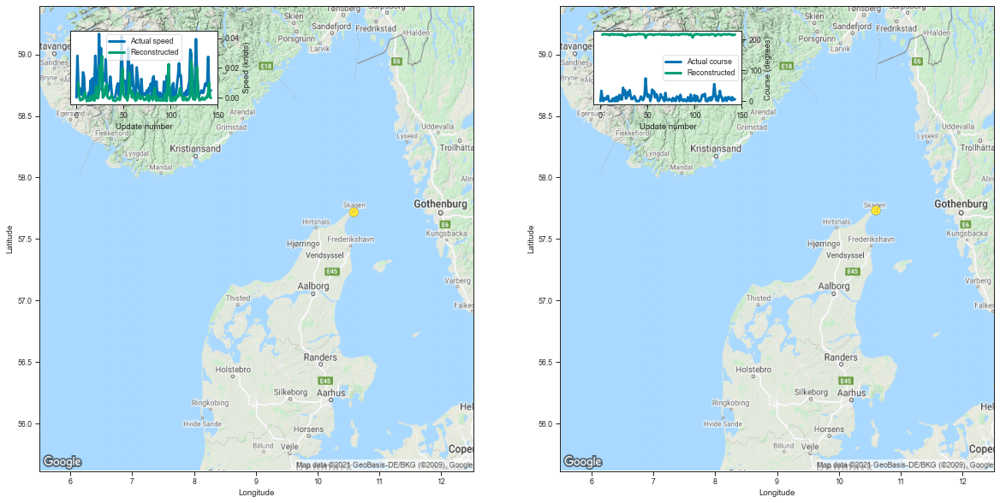

[0.010445475578308105, 0.0002976655960083008, -0.0019997358322143555, -0.0008095502853393555]


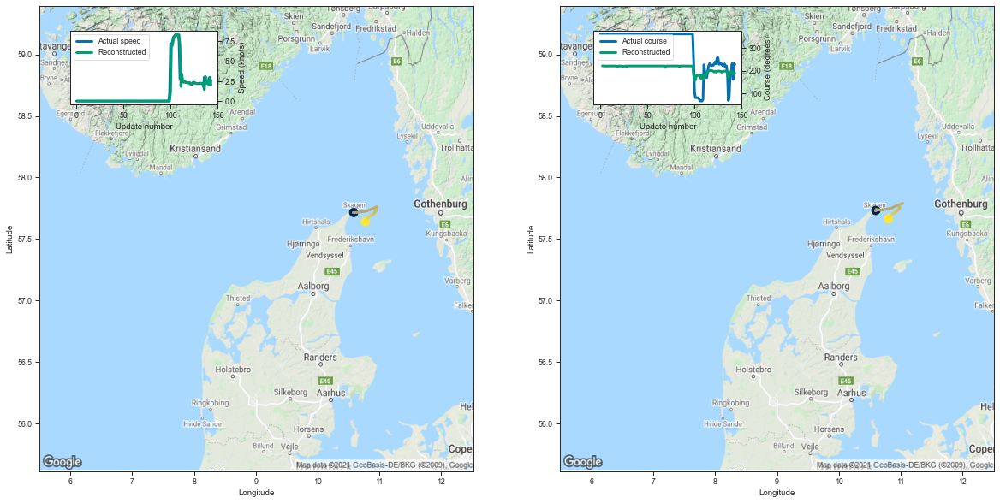

[-0.006195425987243652, -0.00471806526184082, -0.0050345659255981445, -0.00351107120513916]


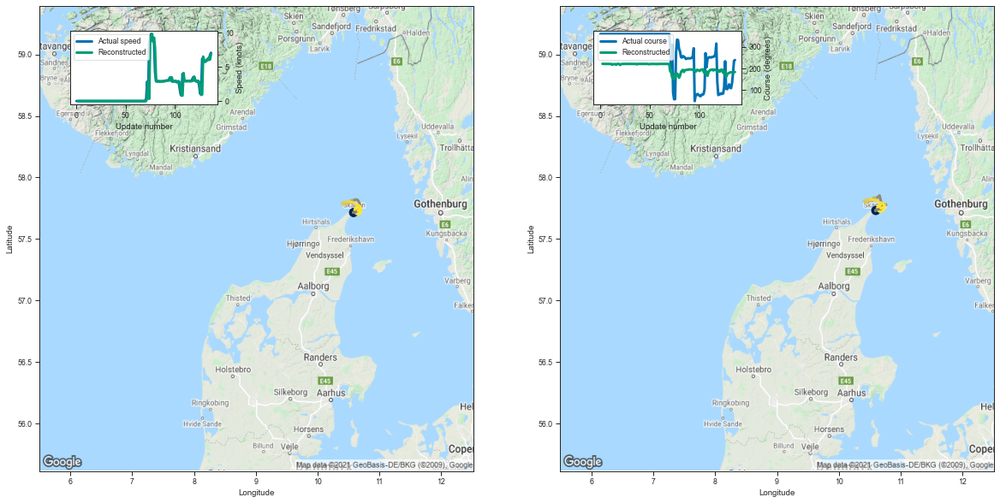

[-0.00726628303527832, -0.004876375198364258, -0.005035758018493652, -0.005045652389526367]


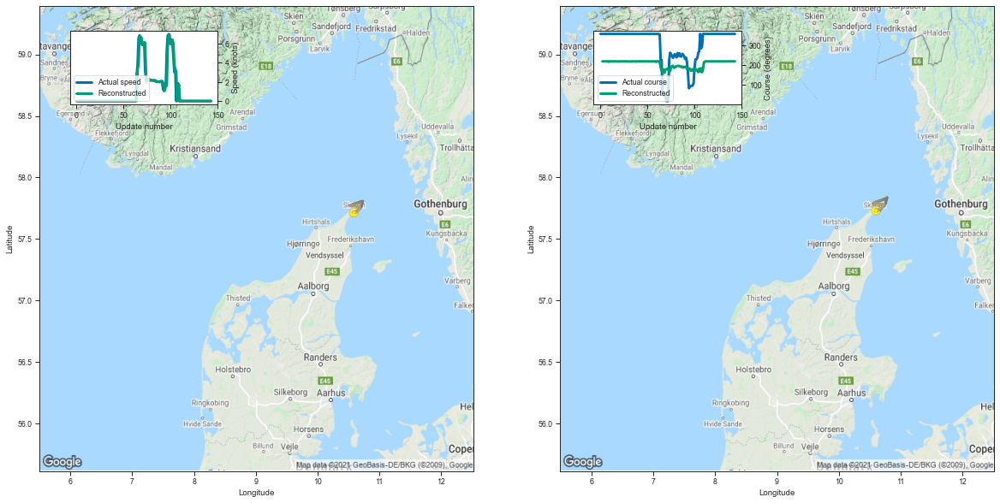

[-0.004610419273376465, -0.004928946495056152, -0.004797816276550293, -0.00561678409576416]


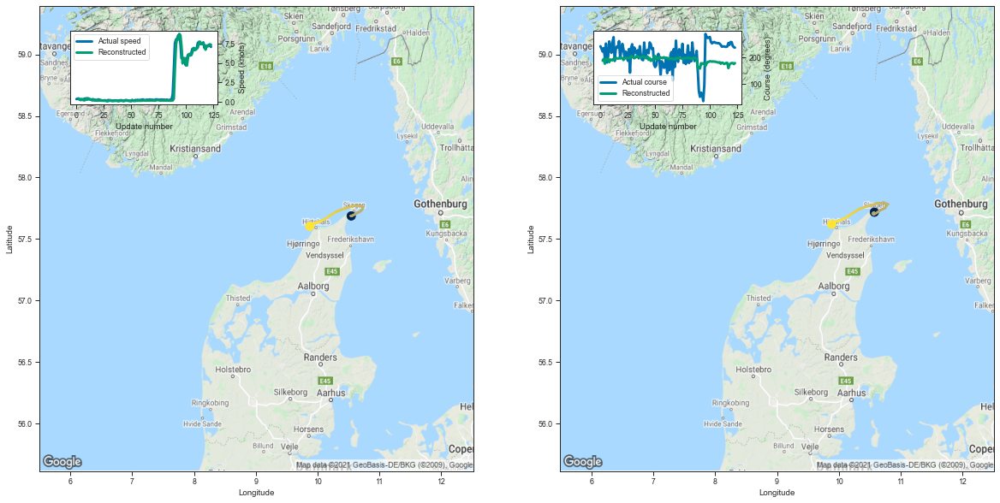

[0.4383954405784607, 0.3149162530899048, 0.20996487140655518, 0.3441128730773926]


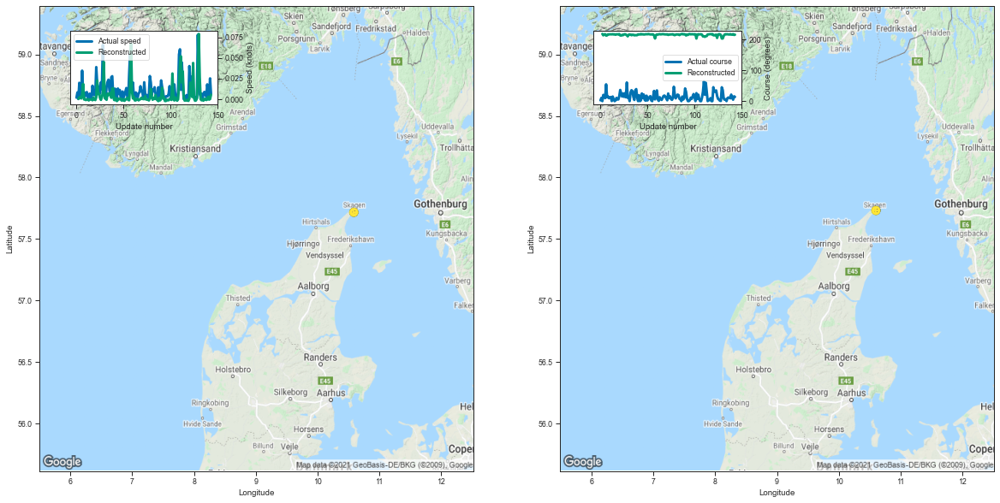

[0.00020039081573486328, 0.0017750263214111328, 0.0026491880416870117, 0.0006258487701416016]


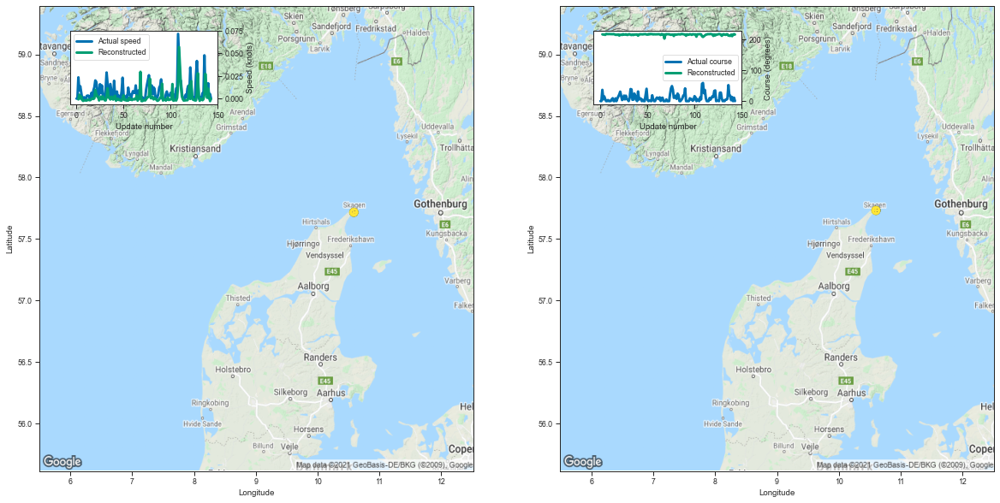

[-0.0009087324142456055, 0.004319429397583008, 0.00014448165893554688, 0.0022667646408081055]


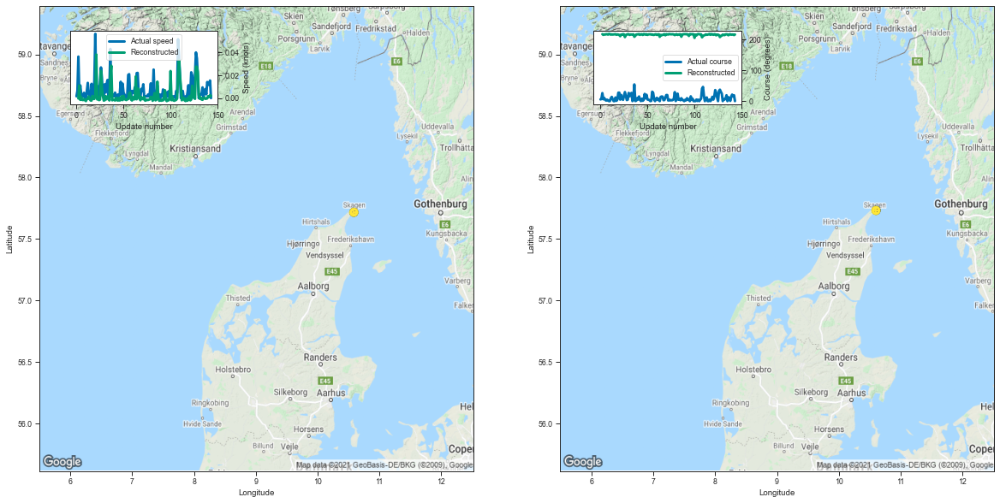

[-0.00032651424407958984, 0.011054039001464844, -0.001538991928100586, 0.0009301900863647461]


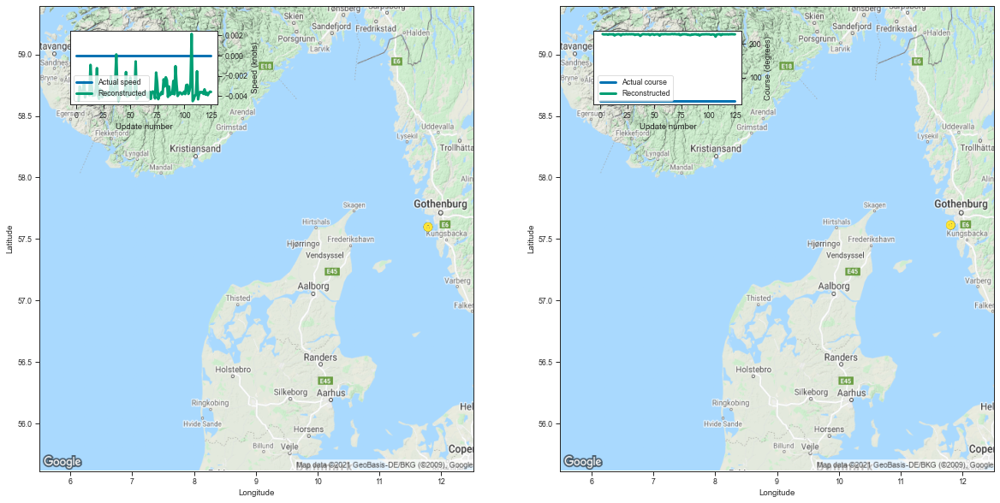

[-0.0044558048248291016, -0.0030736923217773438, -0.0035592317581176758, -0.003721952438354492]


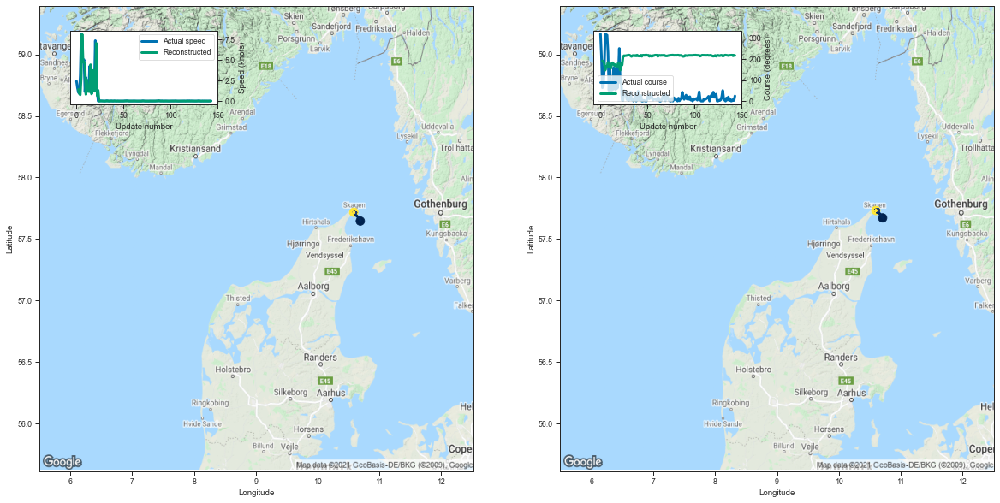

[1.4214096069335938, 0.9040757417678833, 0.7639998197555542, 2.8311421871185303]


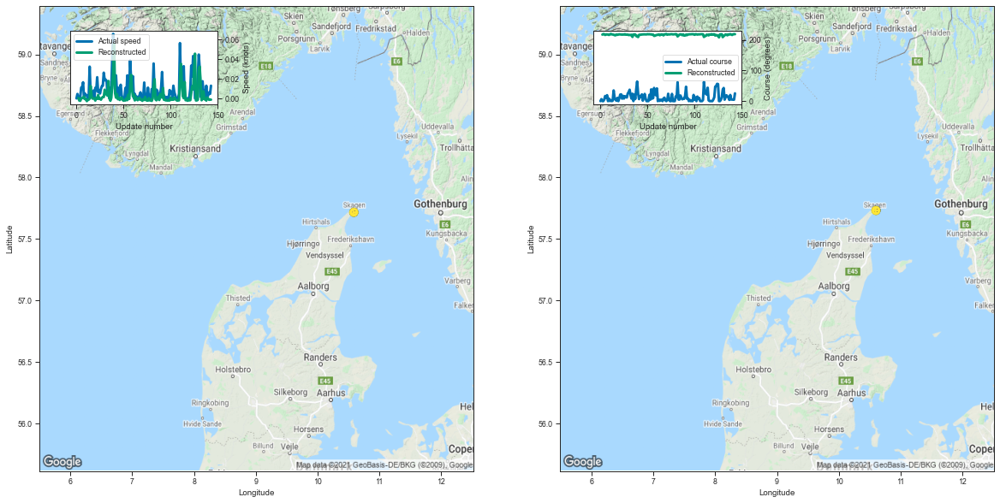

[0.00040853023529052734, -0.0022104978561401367, -0.0024379491806030273, -1.2993812561035156e-05]


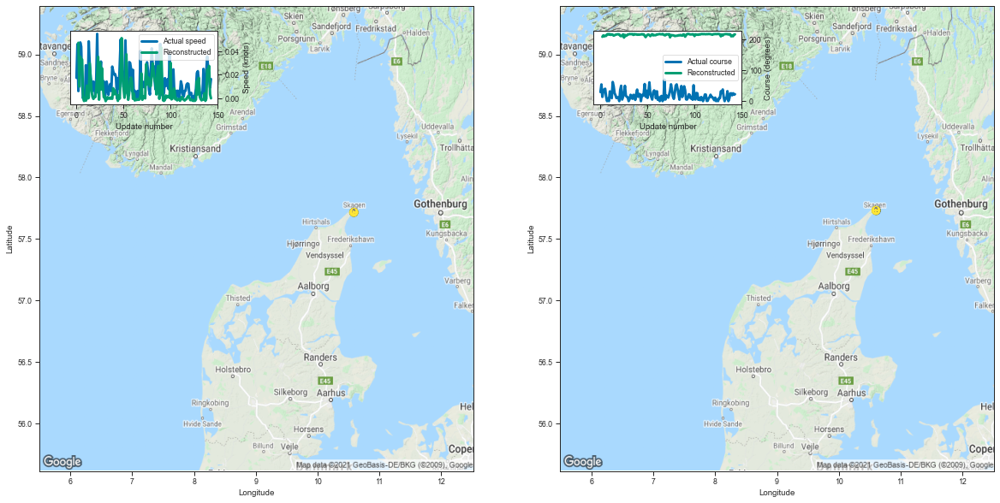

[0.04717254638671875, 0.010100960731506348, 0.03538346290588379, 0.03214120864868164]


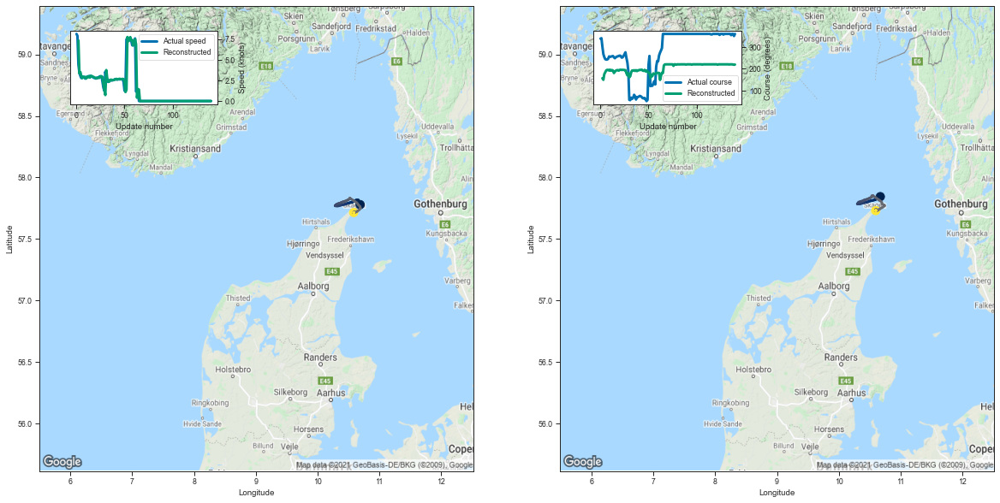

[7.314709186553955, 3.331052780151367, 3.5089669227600098, 3.0186948776245117]


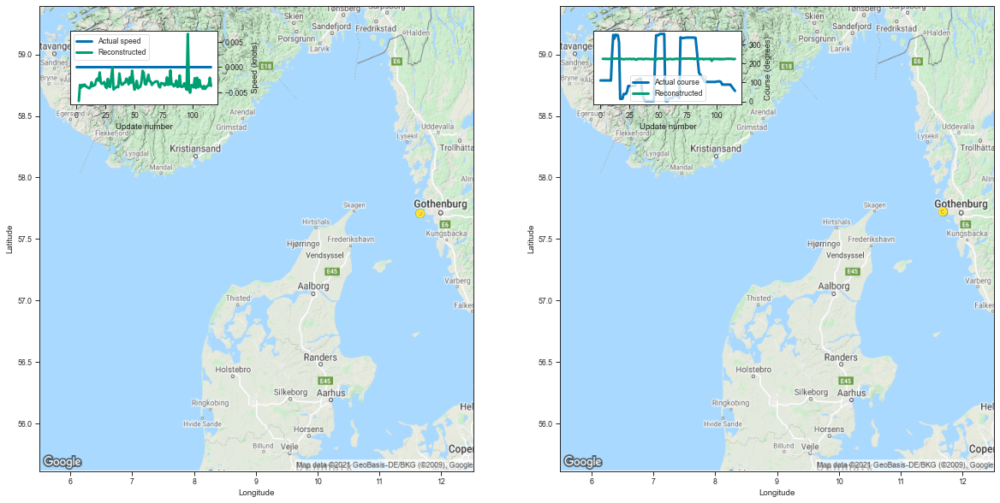

[-0.006754875183105469, -0.0035486221313476562, -0.004069924354553223, -0.0035434961318969727]


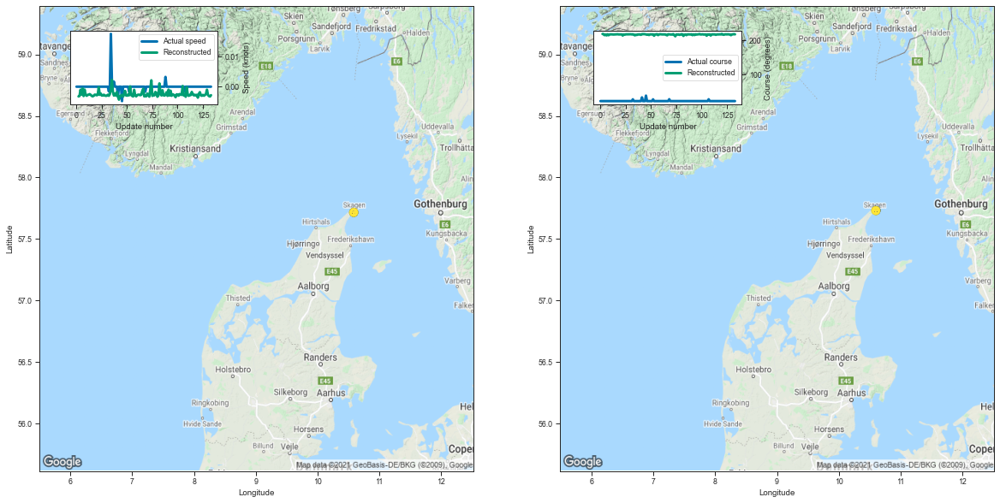

[-0.00321352481842041, -0.0030618906021118164, -0.0010160207748413086, -0.0026131868362426758]


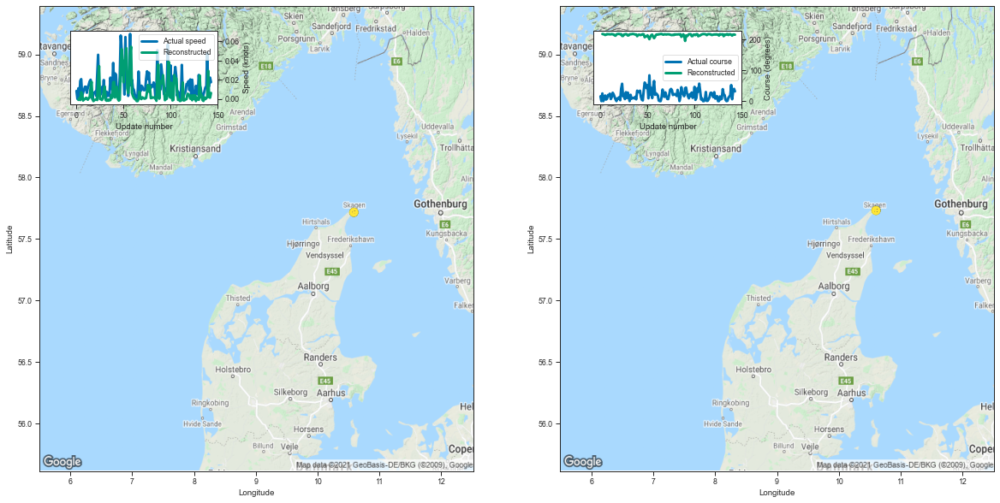

[-0.0010066032409667969, 0.000719904899597168, -0.0011377334594726562, 0.007018923759460449]


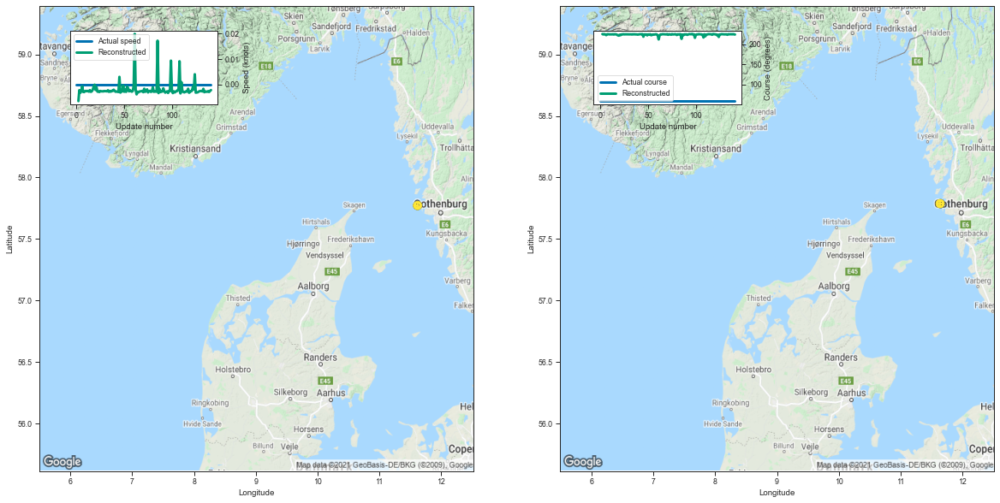

[-0.0065833330154418945, -0.0023040771484375, -0.0033452510833740234, -0.002703547477722168]


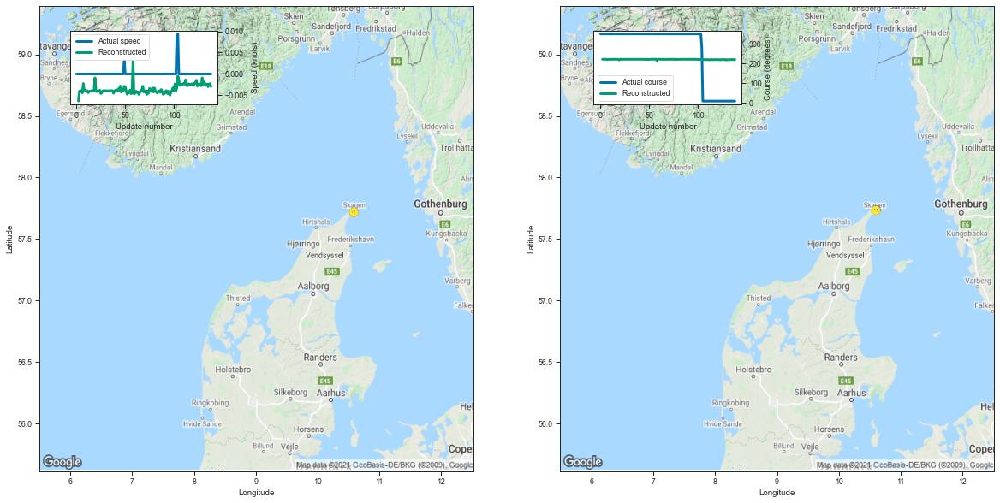

[-0.006343722343444824, -0.004004240036010742, -0.003972172737121582, -0.003913164138793945]


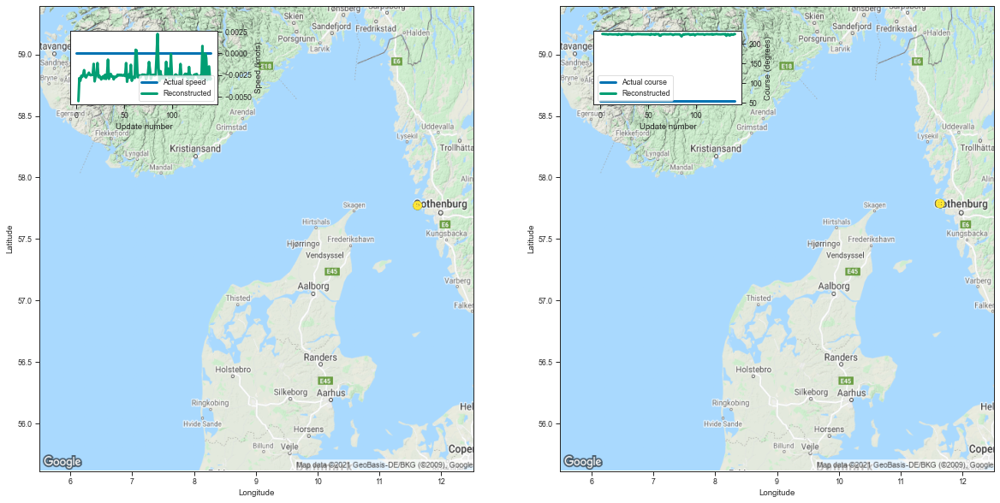

[-0.0055158138275146484, -0.0028687715530395508, -0.0031828880310058594, -0.0026105642318725586]


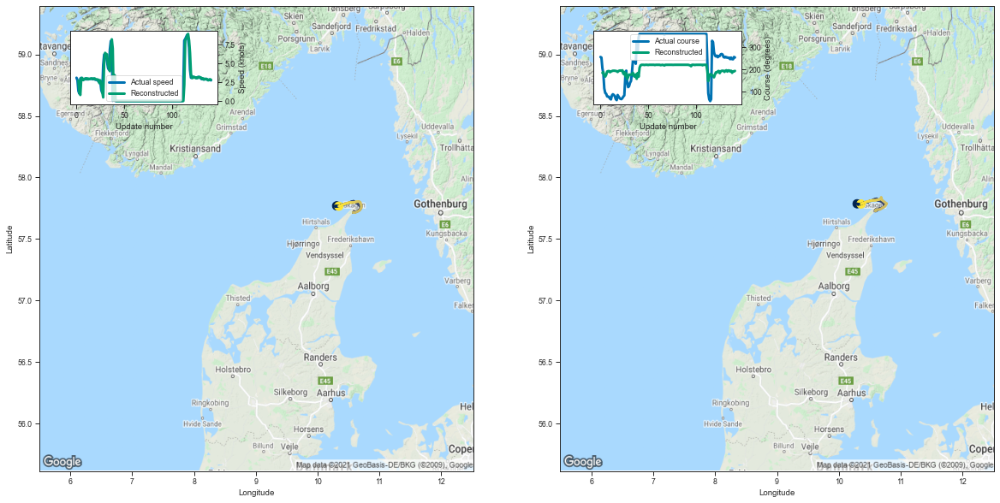

[2.707165002822876, 1.1272554397583008, 0.8071619272232056, 3.029346227645874]


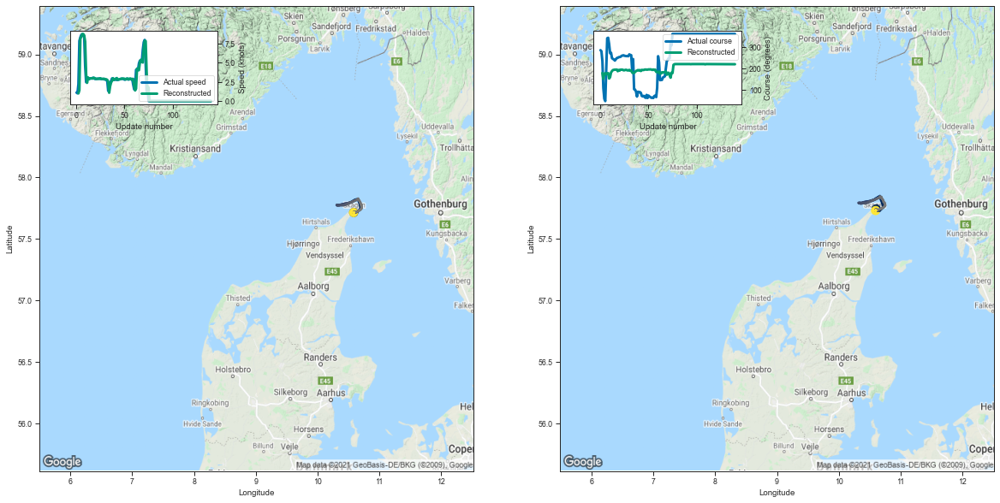

[0.9993245601654053, 1.4180126190185547, 8.146167755126953, 8.38778018951416]


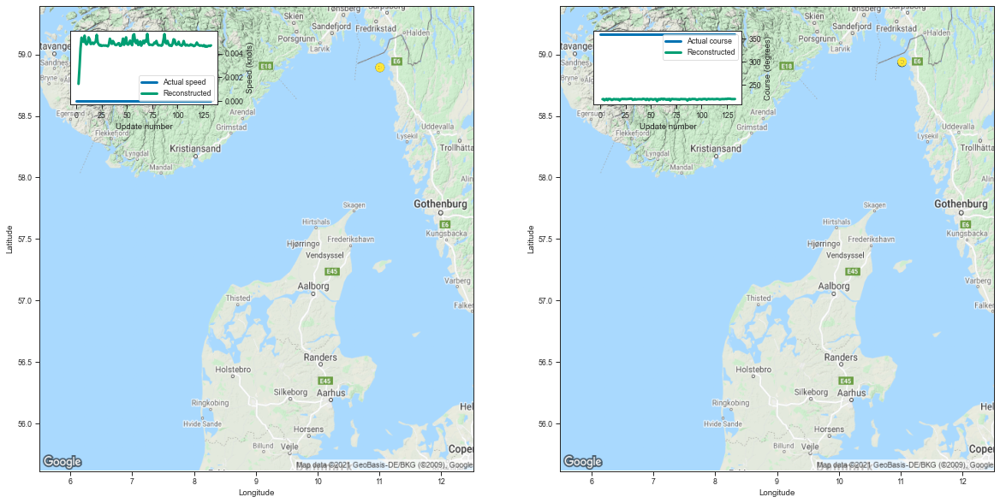

[0.0014518499374389648, 0.002843618392944336, 0.0044519901275634766, 0.005341529846191406]


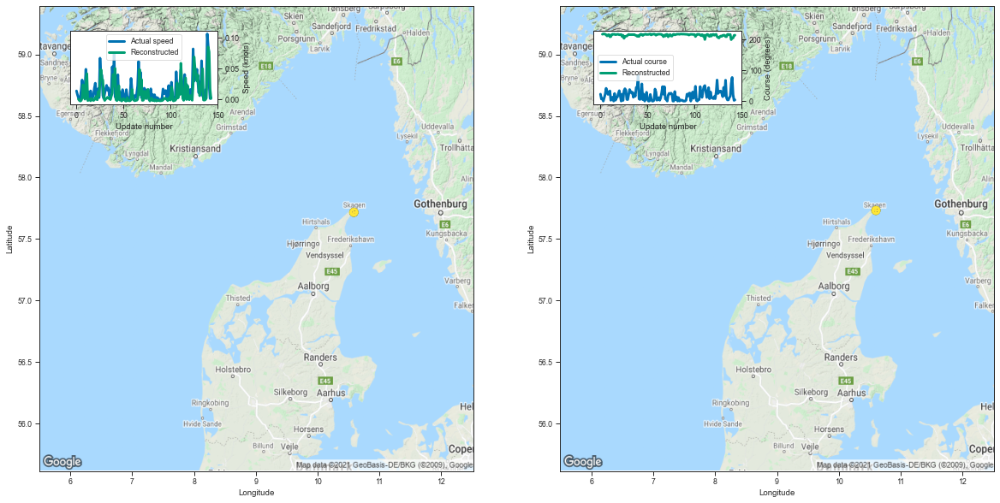

[0.0007239580154418945, -0.0013374090194702148, -0.002500772476196289, -0.0014792680740356445]


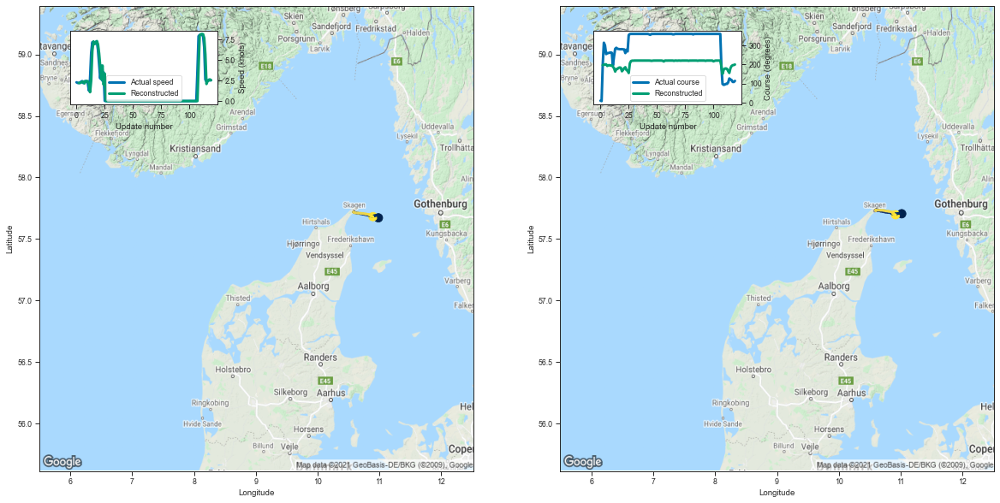

[2.2022149562835693, 2.196208953857422, 2.235722064971924, 2.3510210514068604]


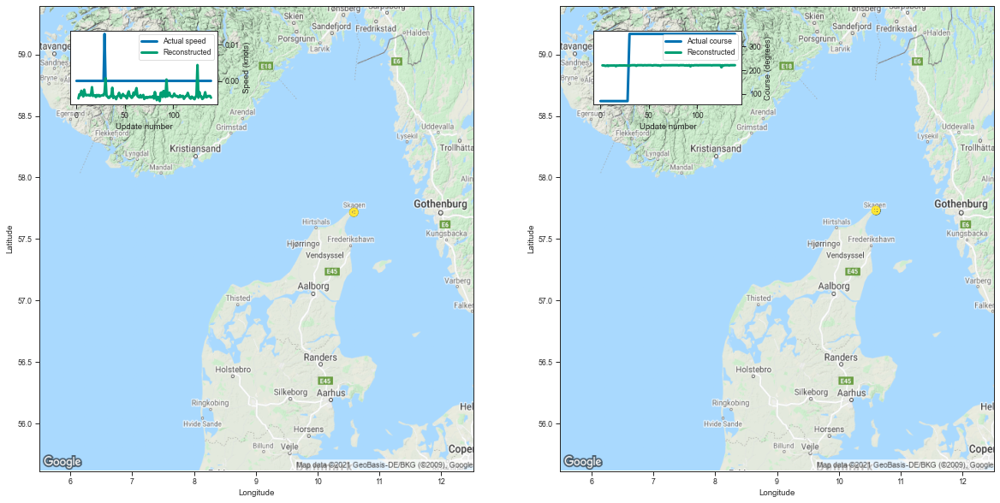

[-0.004807829856872559, -0.0036829710006713867, -0.003945589065551758, -0.0027283430099487305]


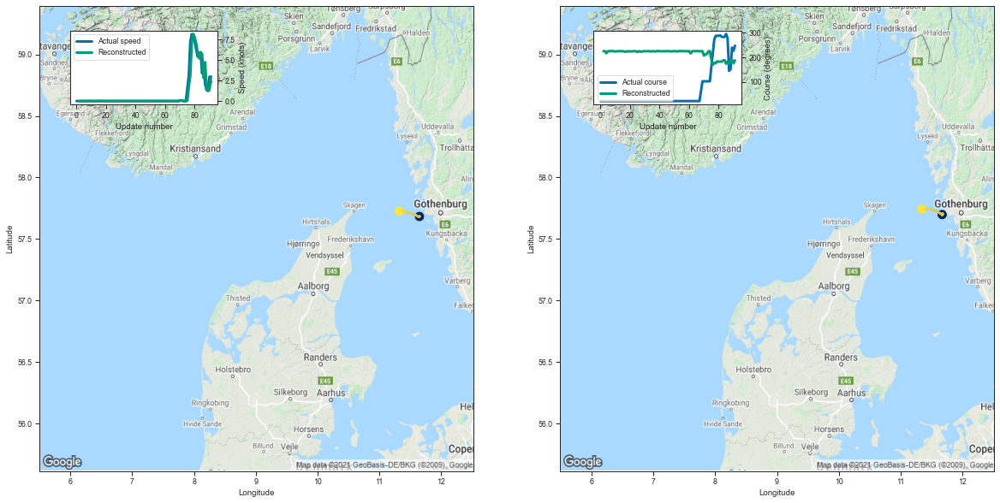

[-0.005049705505371094, -0.0021114349365234375, 0.006537795066833496, -0.003493666648864746]


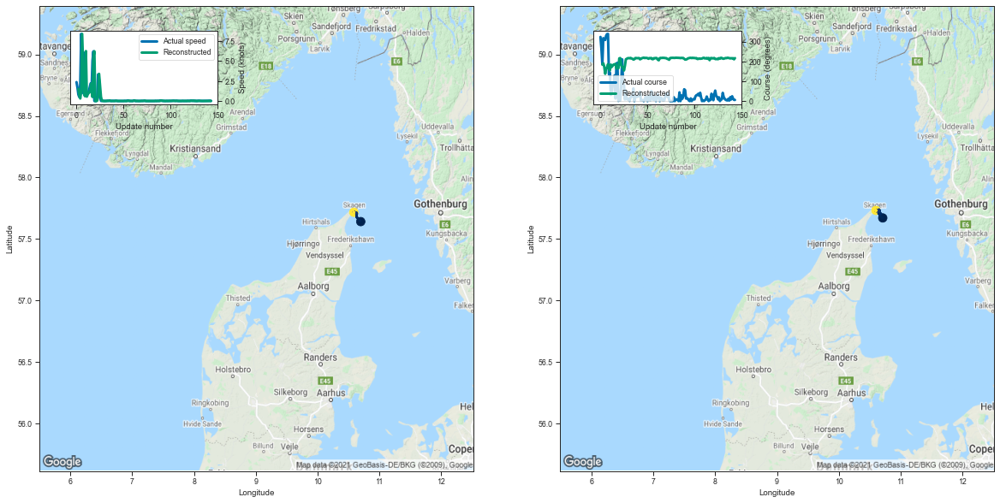

[1.5228521823883057, 0.7053561210632324, 0.3152298927307129, 1.2198644876480103]


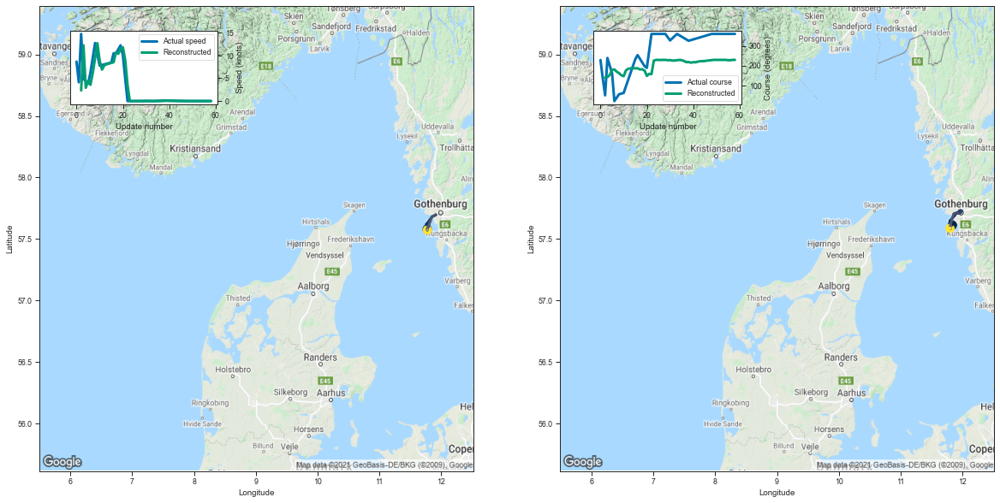

[2.313258409500122, 12.205826759338379, 2.908385753631592, 4.437938690185547]


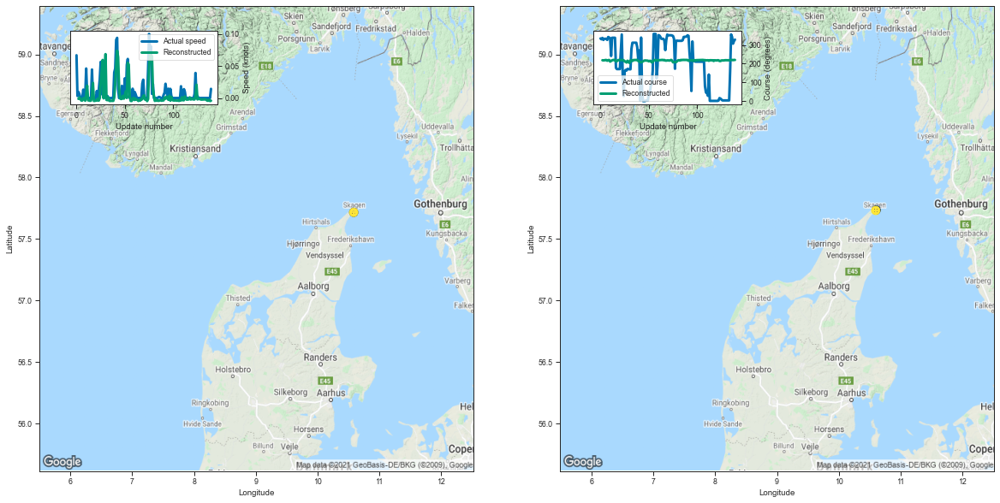

[-0.0013189315795898438, 0.0007909536361694336, -0.0014858245849609375, -0.003910422325134277]


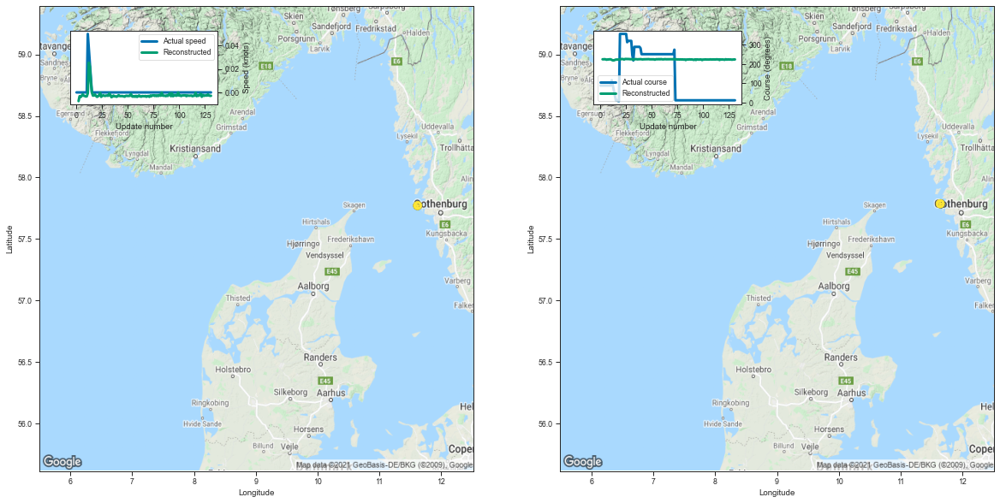

[-0.007417559623718262, -0.0032345056533813477, -0.003989100456237793, -0.0031325817108154297]


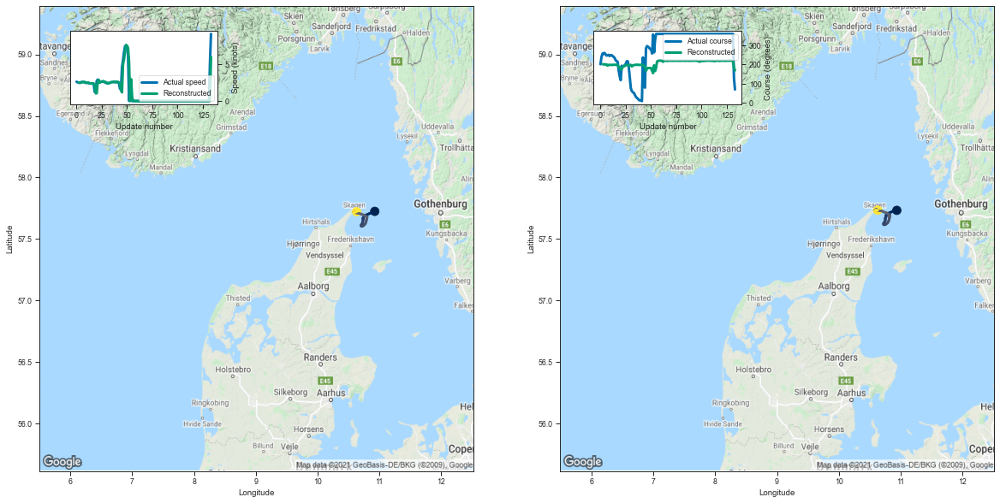

[2.5449485778808594, 2.499894618988037, 2.479649066925049, 2.54954195022583]


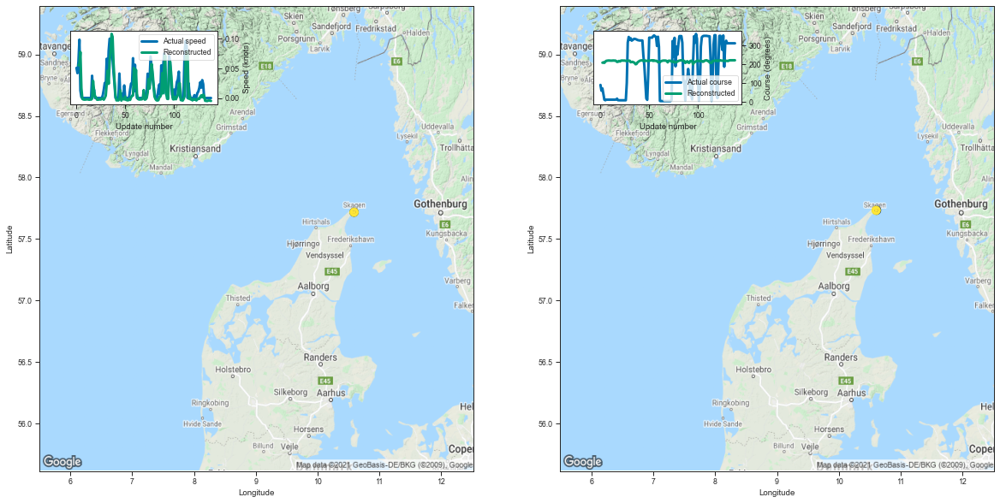

[0.05539047718048096, 0.055300235748291016, 0.07763051986694336, 0.01648533344268799]


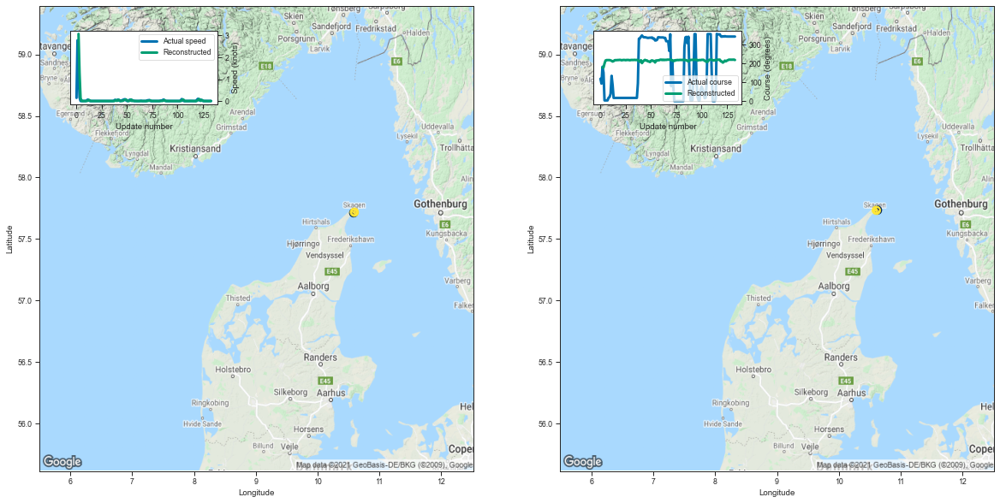

[3.070645570755005, 1.2821290493011475, 0.13304078578948975, 0.002167820930480957]


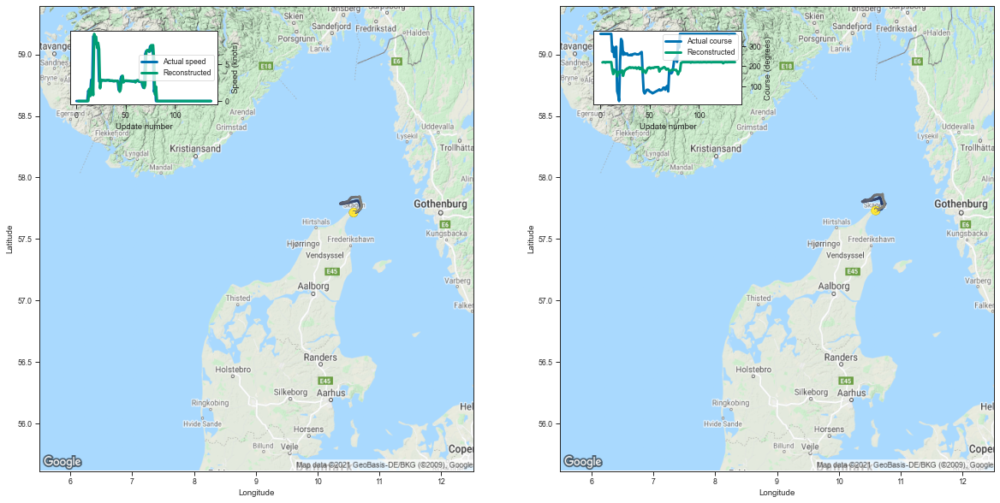

[-0.004994750022888184, -0.004925727844238281, -0.005131244659423828, -0.0020521879196166992]


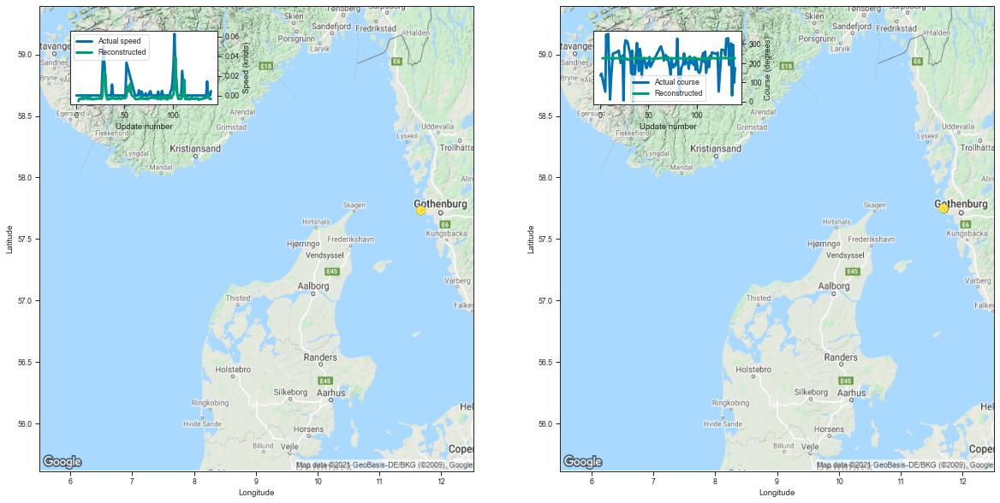

[-0.005693912506103516, -0.0033707618713378906, -0.003476381301879883, -0.0035277605056762695]


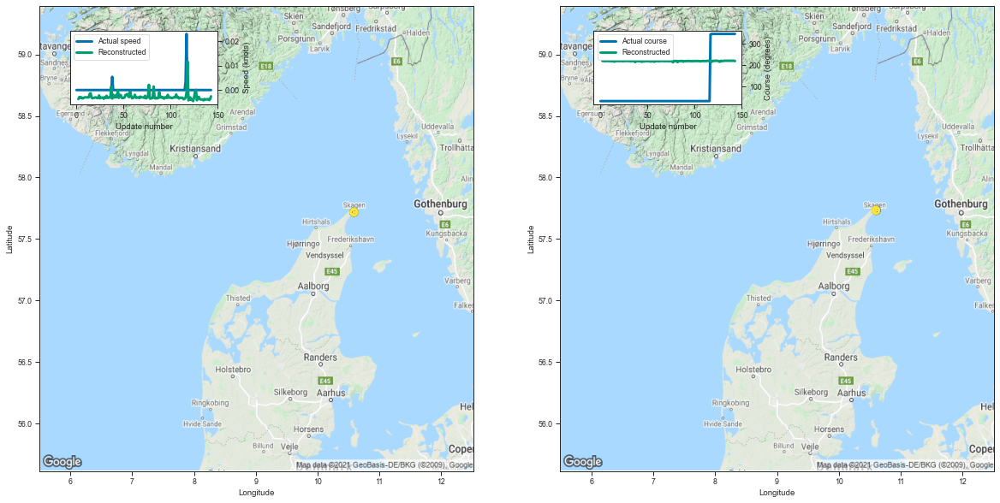

[-0.0036829710006713867, -0.002852916717529297, -0.0031636953353881836, -0.0029436349868774414]


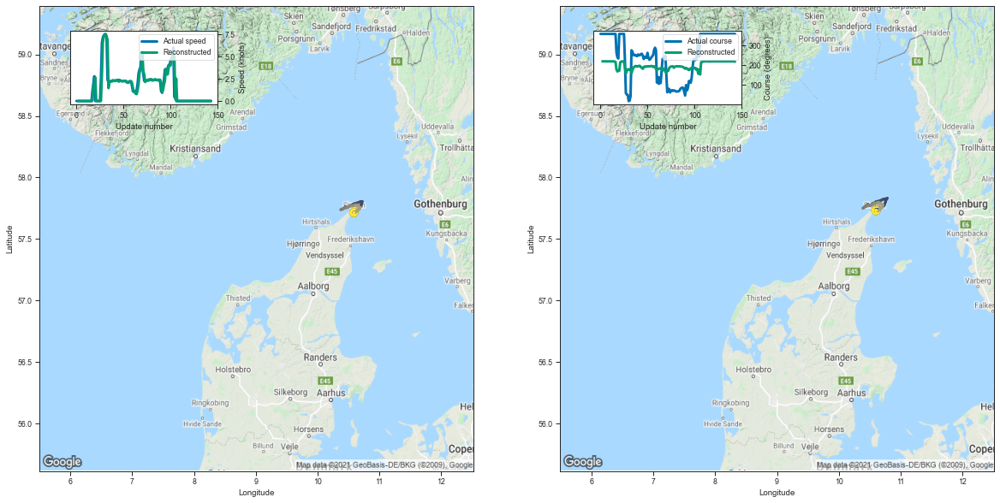

[-0.0068749189376831055, -0.0051697492599487305, -0.0052405595779418945, -0.005414724349975586]


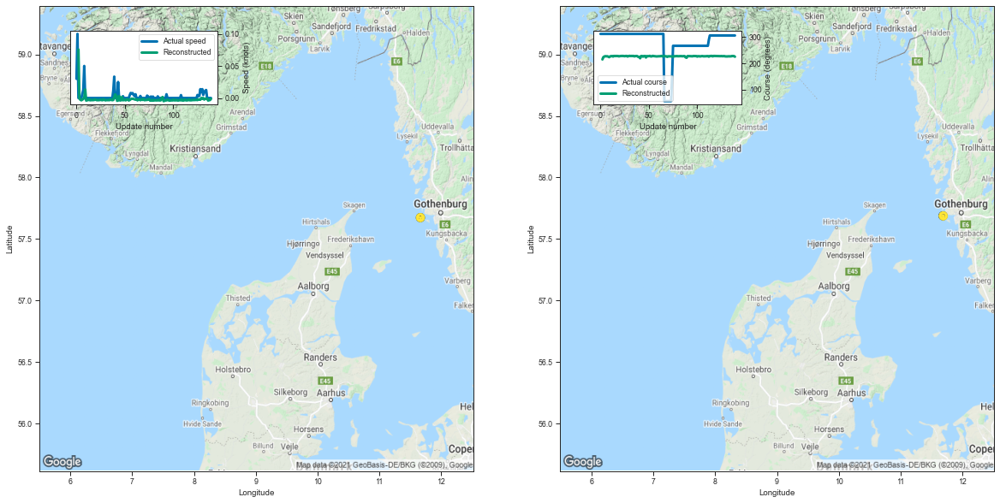

[0.07559502124786377, -0.000919342041015625, -0.0026739835739135742, -0.003511786460876465]


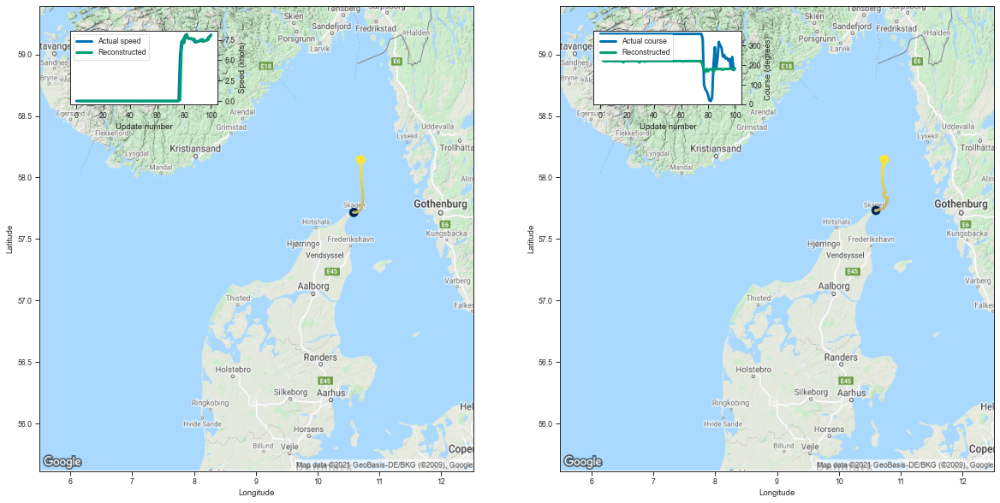

[-0.00659942626953125, -0.005448818206787109, -0.002837657928466797, -0.005157113075256348]


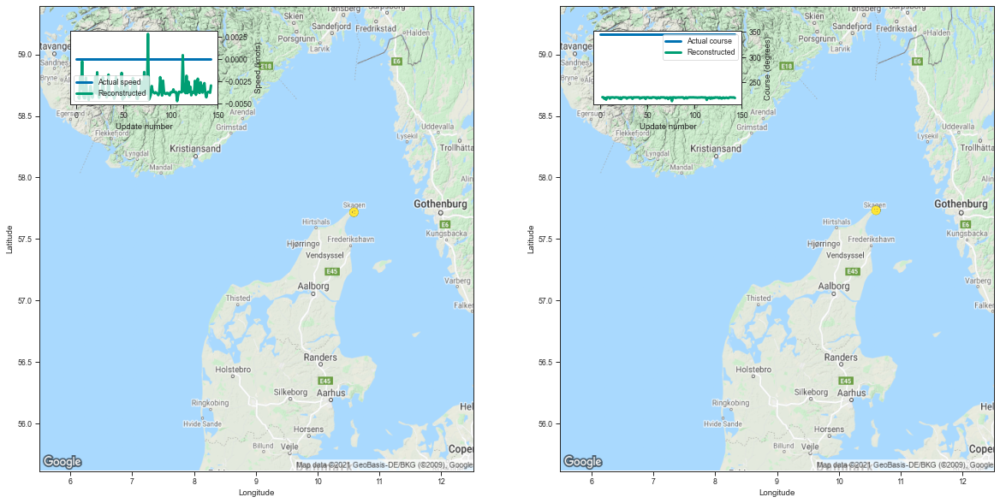

[-0.004287600517272949, -0.004458069801330566, -0.00200653076171875, -0.0032830238342285156]


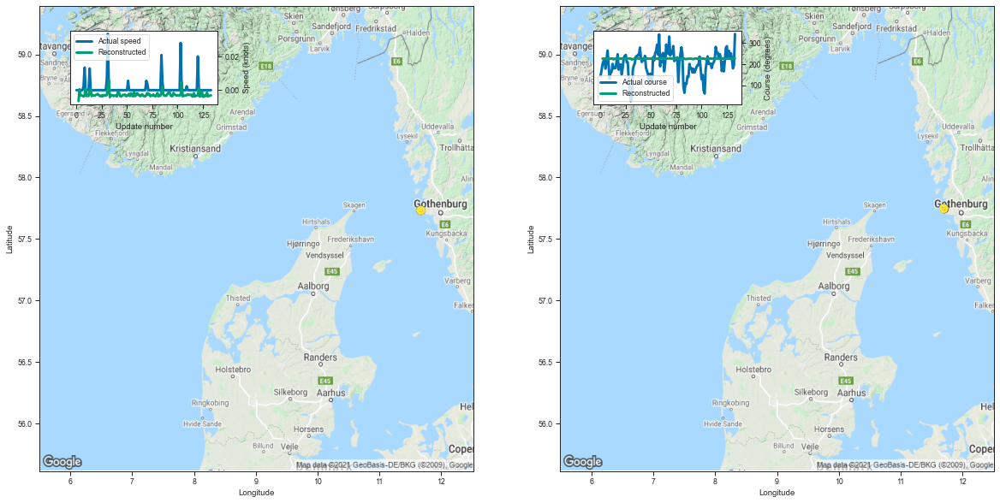

[-0.006493210792541504, 0.0004544258117675781, -0.0032280683517456055, -0.0031183958053588867]


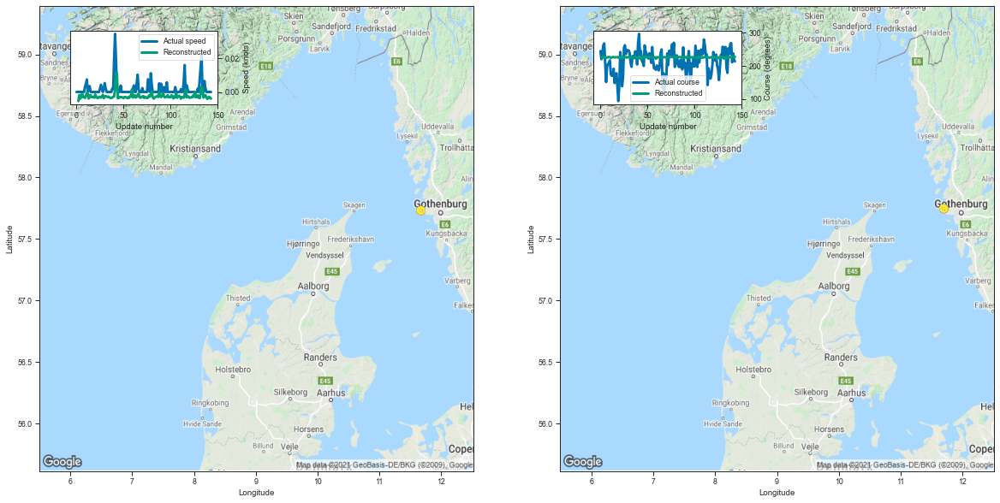

[-0.005419254302978516, -0.0018814802169799805, -0.0039520263671875, -0.003036022186279297]


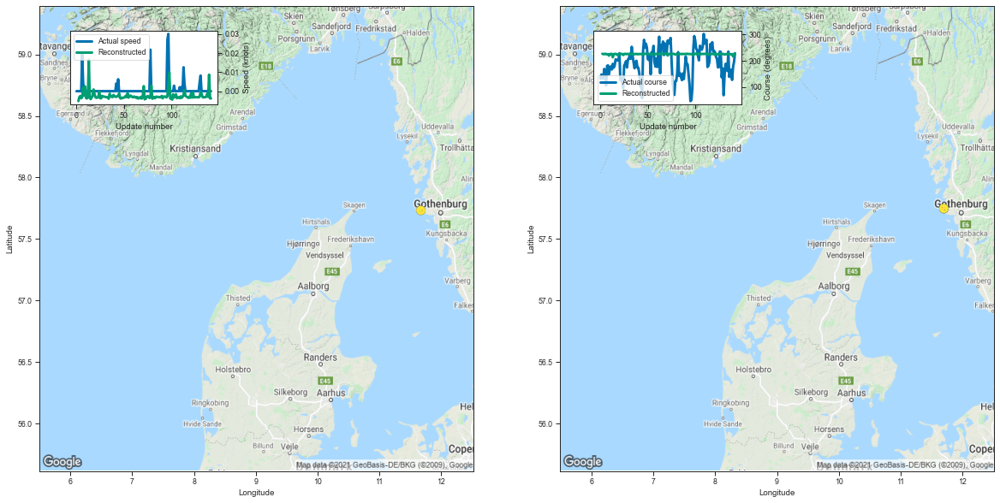

[-0.005202054977416992, -0.0031366348266601562, -0.0025441646575927734, -0.0036772489547729492]


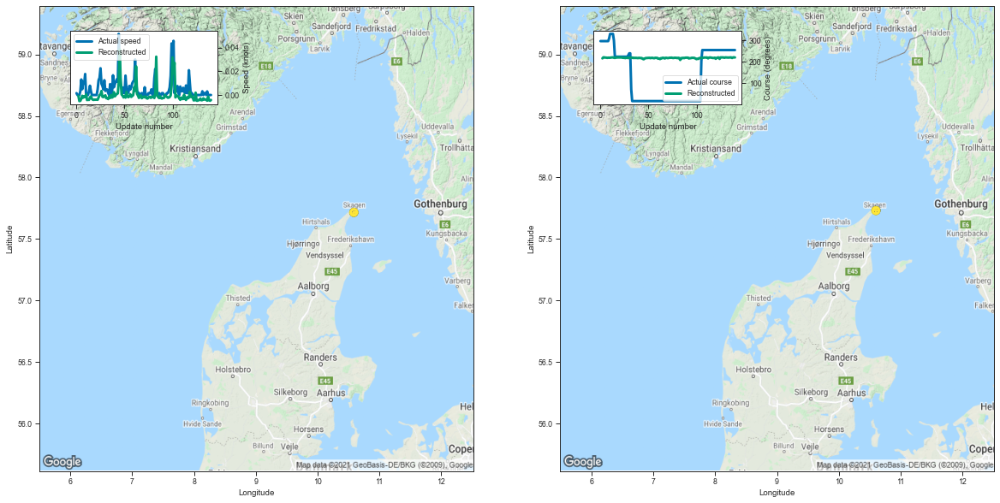

[-0.0007673501968383789, -0.005141496658325195, -0.004890084266662598, -0.003153204917907715]


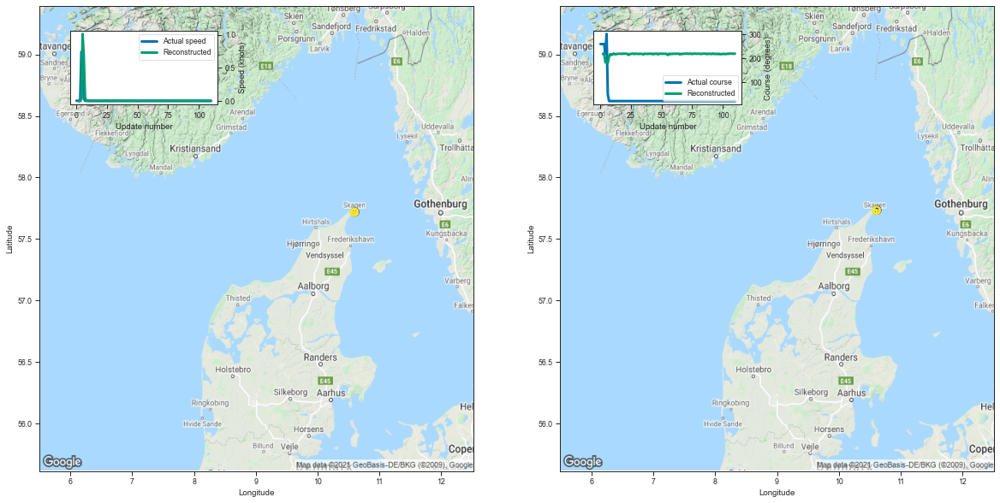

[-0.003915071487426758, -0.004831075668334961, 0.028960108757019043, 1.0118542909622192]


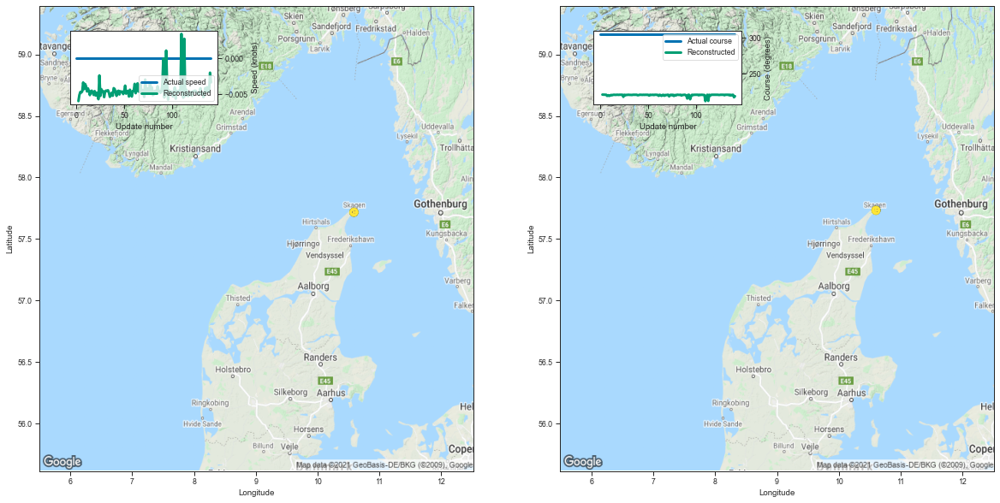

[-0.0059697628021240234, -0.005142331123352051, -0.004709362983703613, -0.00478363037109375]


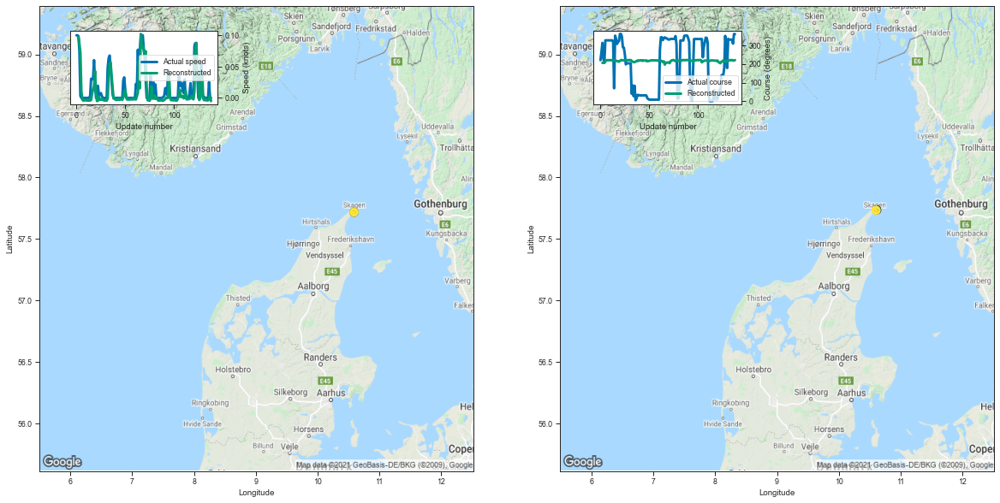

[0.09795677661895752, 0.08593761920928955, 0.07190537452697754, 0.010849475860595703]


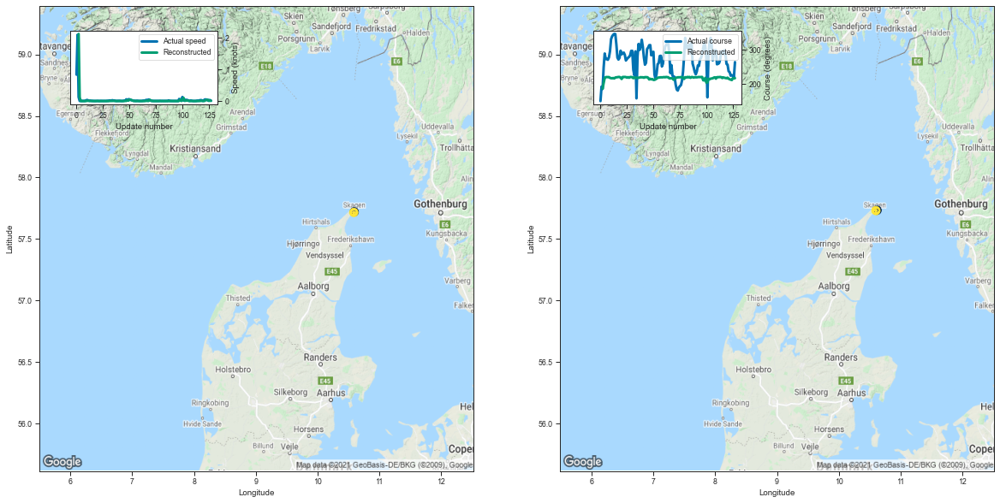

[2.115748405456543, 0.11024975776672363, -0.0011445283889770508, -0.004662632942199707]


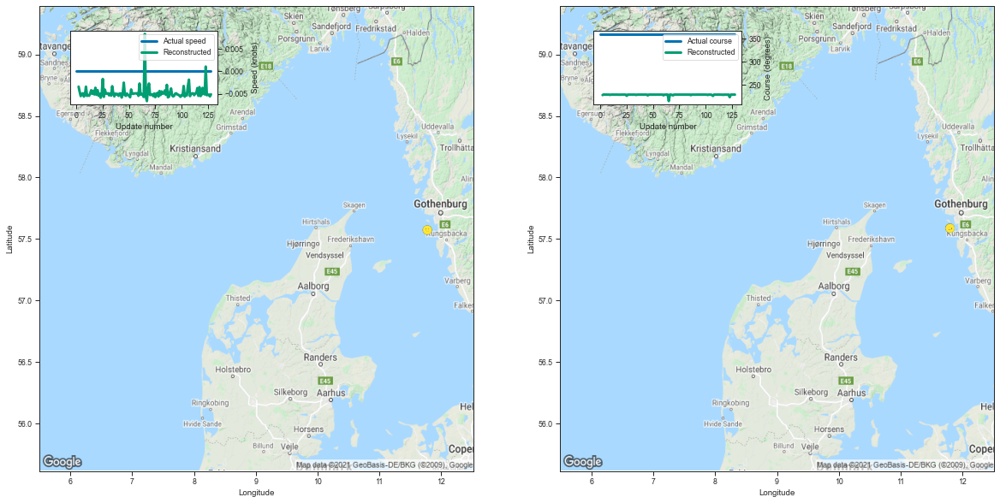

[-0.0034154653549194336, -0.004544377326965332, -0.005521297454833984, -0.005087733268737793]


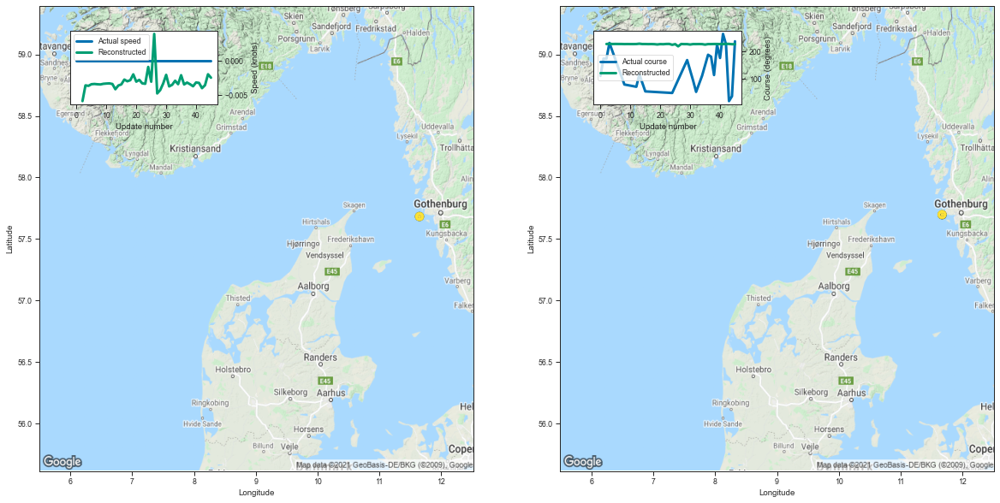

[-0.00586247444152832, -0.00358426570892334, -0.0036557912826538086, -0.003419160842895508]


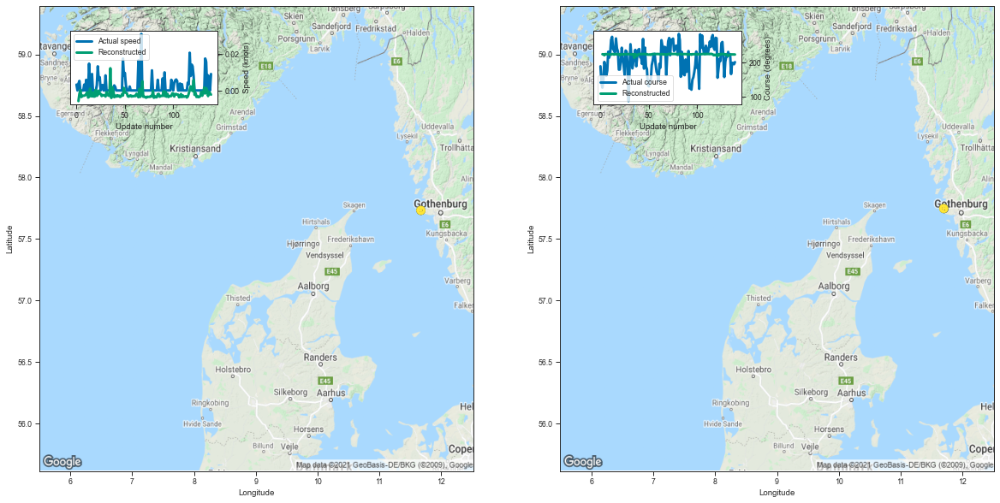

[-0.005881786346435547, -0.001950383186340332, 0.0001379251480102539, -0.003630399703979492]


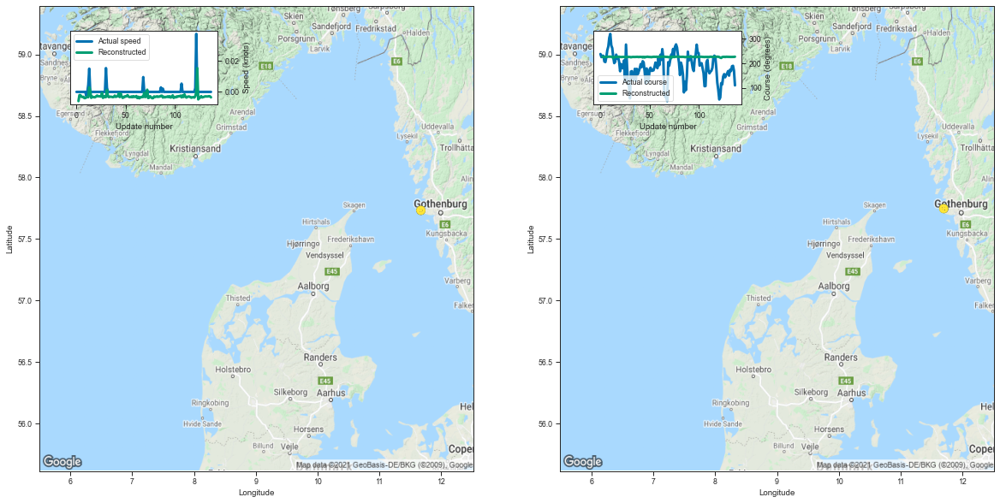

[-0.005861997604370117, -0.00205838680267334, -0.002077341079711914, -0.0030988454818725586]


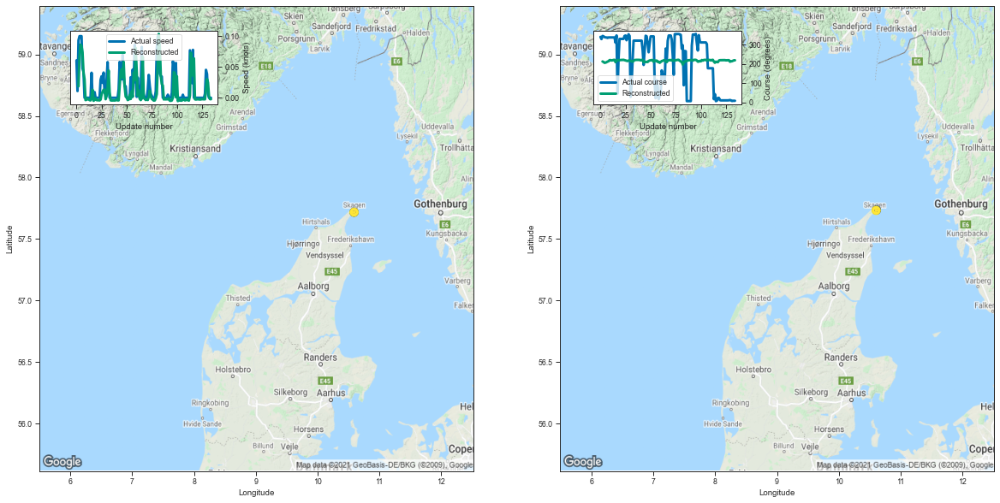

[0.018671751022338867, 0.06620585918426514, 0.08624708652496338, 0.08386850357055664]


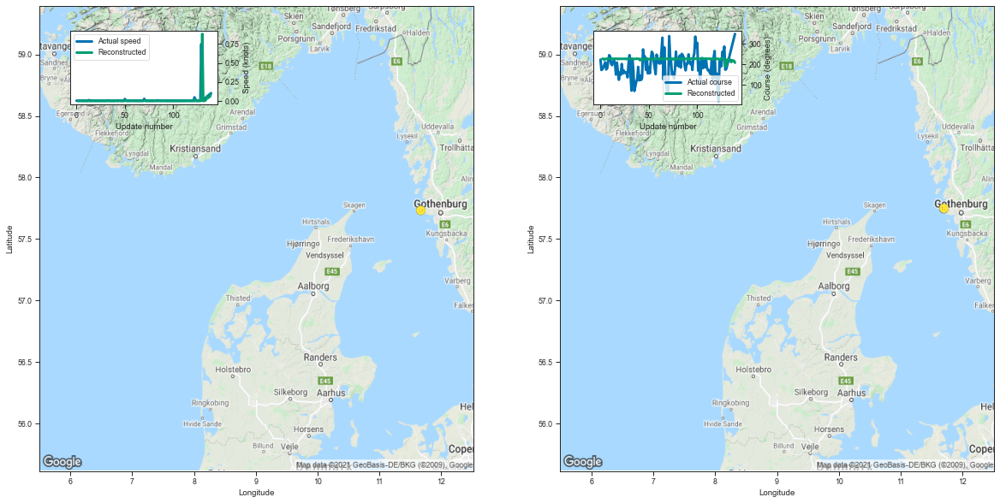

[-0.005318284034729004, -0.0028210878372192383, 0.002358675003051758, -0.0031148195266723633]


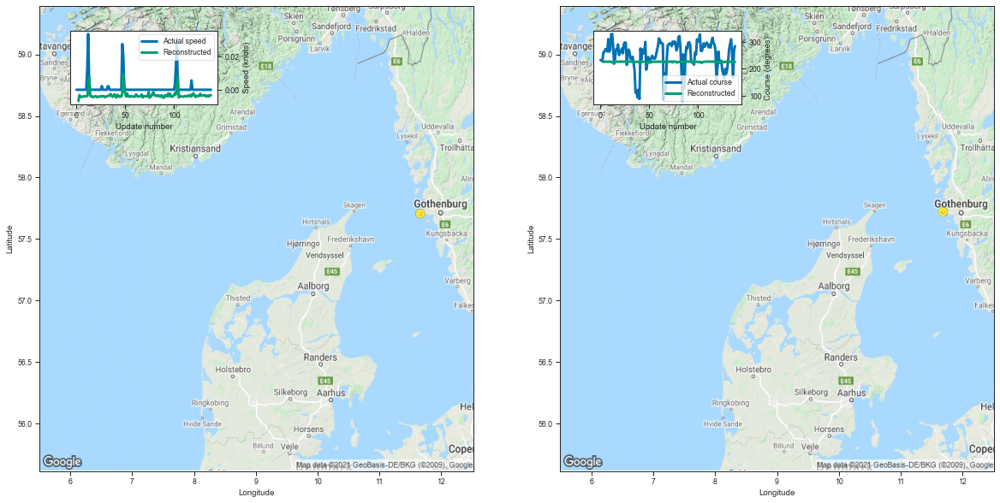

[-0.006897568702697754, -0.003291010856628418, -0.004309296607971191, -0.004414677619934082]


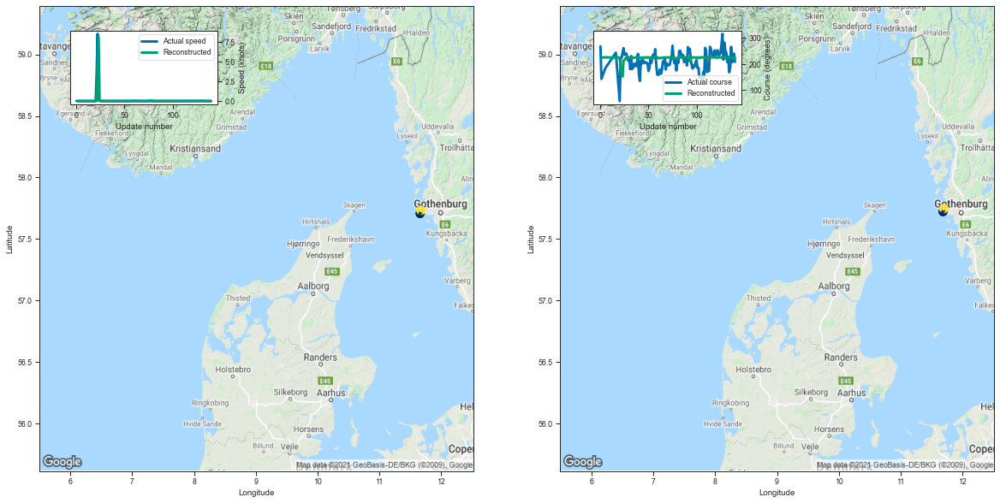

[-0.005745530128479004, -0.002962470054626465, -0.004036068916320801, -0.0034934282302856445]


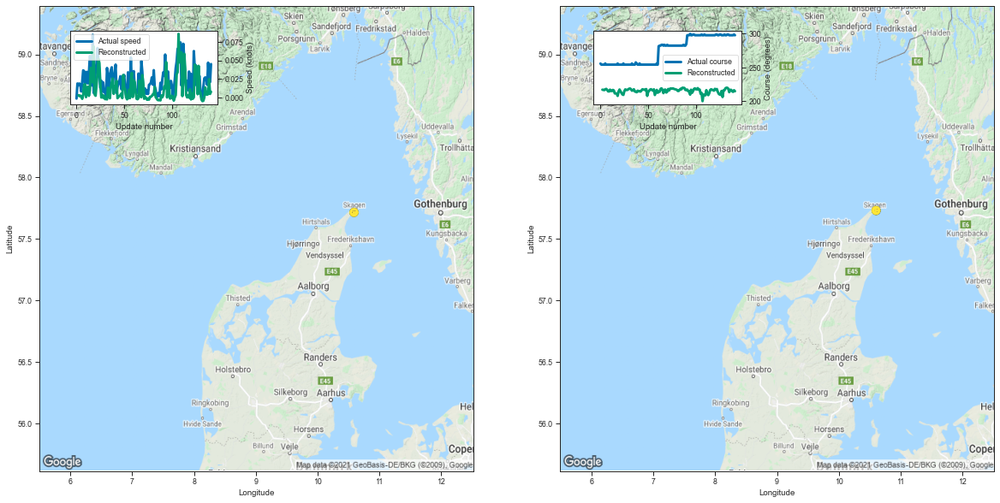

[0.0029969215393066406, 0.0017217397689819336, 0.0024650096893310547, 0.0009379386901855469]


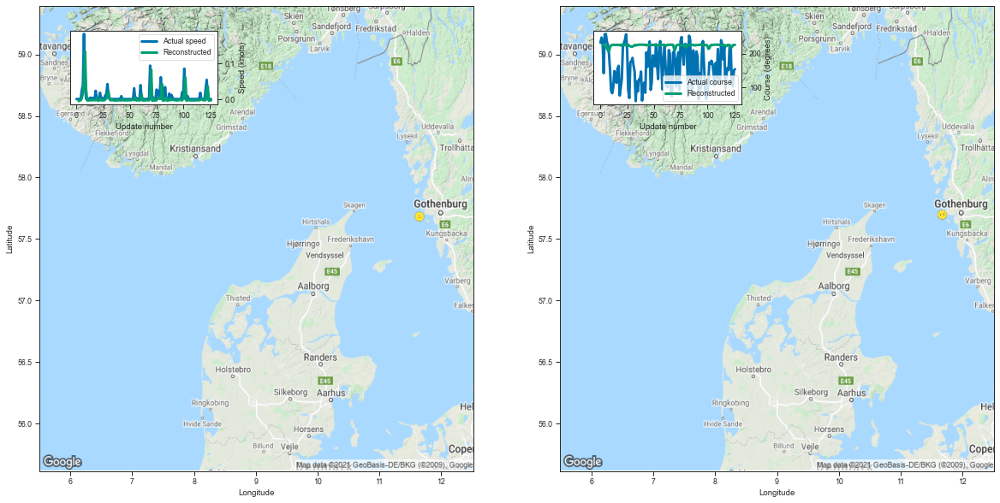

[-0.005702018737792969, -0.0031893253326416016, -0.0034019947052001953, 0.0028275251388549805]


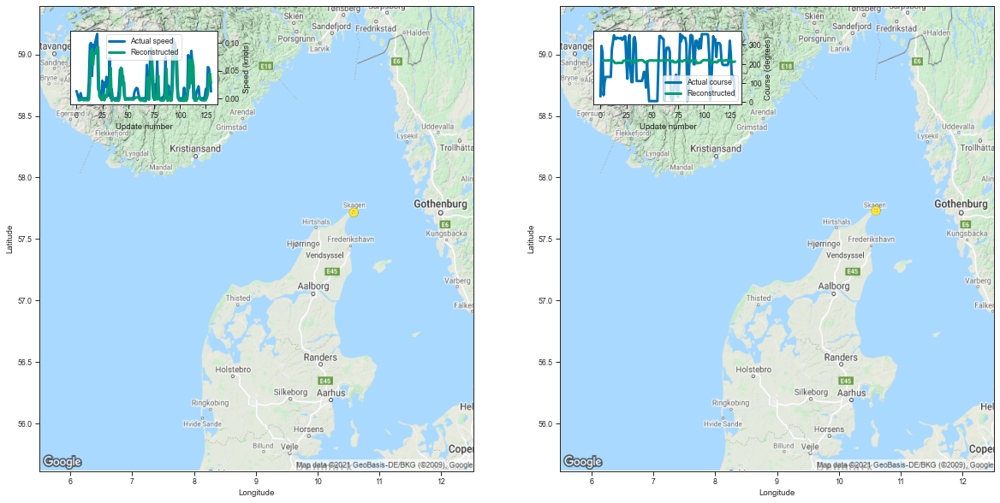

[-0.0033757686614990234, -0.0038863420486450195, -0.0027436017990112305, -0.0014263391494750977]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
1568,1568,107625928,219024411,Fishing,80,-1518.268677,-18.978358
1683,1683,218511549,257979790,Fishing,138,-2578.873291,-18.687488
800,800,74783139,219011018,Fishing,144,-2169.948486,-15.069087
2532,2532,79057675,219011953,Fishing,144,-1645.048462,-11.423948
1927,1927,12152858,219000897,Fishing,133,-1505.809326,-11.321875
...,...,...,...,...,...,...,...
1038,1038,239138330,266065000,Fishing,139,-1096.541138,-7.888785
2122,2122,246389777,266145000,Fishing,141,-1107.525635,-7.854792
2672,2672,192125686,231100000,Fishing,142,-1111.048828,-7.824288
2139,2139,257087310,266322000,Fishing,127,-992.042603,-7.811359


In [9]:
# Focus on the overall n=100 worst reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n